First we load the required packages.

In [44]:

import matplotlib.pyplot as plt
from matplotlib import colormaps
import numpy as np
import pandas as pd
import seaborn as sns  
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from scipy.stats import chi2_contingency
from scipy.stats import kruskal
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from scipy.stats import pearsonr
import plotly.express as px

In [45]:
#df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')

#df = df[~df['Species_name'].str.endswith('_2')]
#df = df[df['Instrument_model'] != 'NextSeq 500']




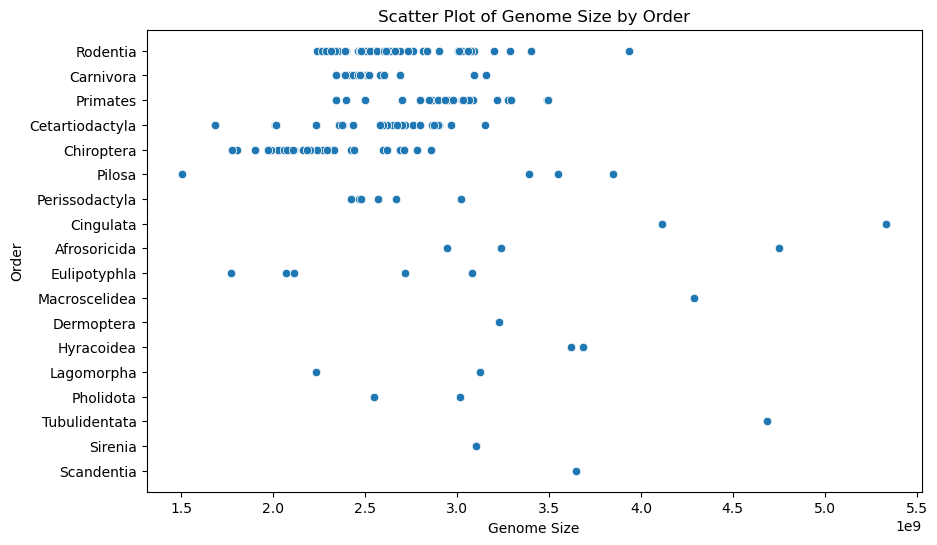

In [46]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Genome_size', y='Order', data=df)
plt.title('Scatter Plot of Genome Size by Order')
plt.xlabel('Genome Size')
plt.ylabel('Order')
plt.show()

Analysis of species and total fusions


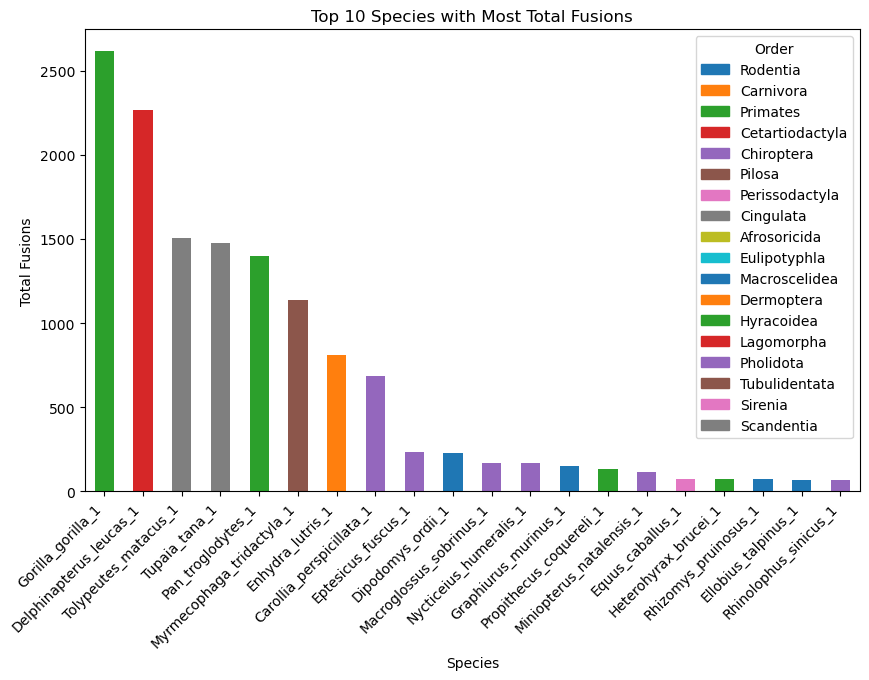

In [47]:



df_filtered = df[df['Species_name'].str.endswith('_1')]

fusion_totals = df_filtered.groupby('Species_name')['Outward_distance_0'].sum()

top_species = fusion_totals.nlargest(20)

order_color_map = {order: color for order, color in zip(df['Order'].unique(), sns.color_palette('tab10', len(df['Order'].unique())))}

orders = df_filtered.set_index('Species_name')['Order']

colors = [order_color_map[orders[species]] for species in top_species.index]

plt.figure(figsize=(10, 6))
top_species.plot(kind='bar', color=colors)
plt.title('Top 10 Species with Most Total Fusions')
plt.xlabel('Species')
plt.ylabel('Total Fusions')
plt.xticks(rotation=45, ha='right')

# Create a legend with the order names and colors
legend_labels = {order: order_name for order, order_name in zip(df['Order'].unique(), df['Order'].unique())}
handles = [plt.Rectangle((0,0),1,1, color=order_color_map[order]) for order in df['Order'].unique()]
plt.legend(handles, legend_labels.values(), title='Order')

plt.show()



In [48]:
df = df.dropna(thresh=df.shape[1] - 4)
df.drop(['Species_name', 'Species', 'Order', 'Genome_coverage', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)

correlation_matrix = df.corr()
correlation_matrix.to_excel('Correlation_matrix_fusions_mouse.xlsx')

In [ ]:
columns = ['Unnamed: 0','Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
correlation_matrix_2 = pd.read_excel('Correlation_matrix_fusions_human.xlsx', index_col='Unnamed: 0', usecols=columns)

Generating P values with pearsonr

In [51]:
correlation_matrix = correlation_matrix.fillna(0)

p_values_df = pd.DataFrame(index=correlation_matrix.columns, columns=correlation_matrix.columns)


for i, column1 in enumerate(correlation_matrix.columns):
    for j, column2 in enumerate(correlation_matrix.columns):
        if i <= j:  
            coef, p_value = pearsonr(correlation_matrix[column1], correlation_matrix[column2])
            p_values_df.loc[column1, column2] = p_value
            p_values_df.loc[column2, column1] = p_value

p_values_df = p_values_df.astype(float)

p_values_df.to_excel('p_values_matrix_fusion_human.xlsx')

In [296]:
columns = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

correlation_matrix_2_p_values = p_values_df[columns]
correlation_matrix_2_p_values.to_excel('Correlation_matrix_fusions_p_value_human.xlsx')


Creating a heat-map with the p-values

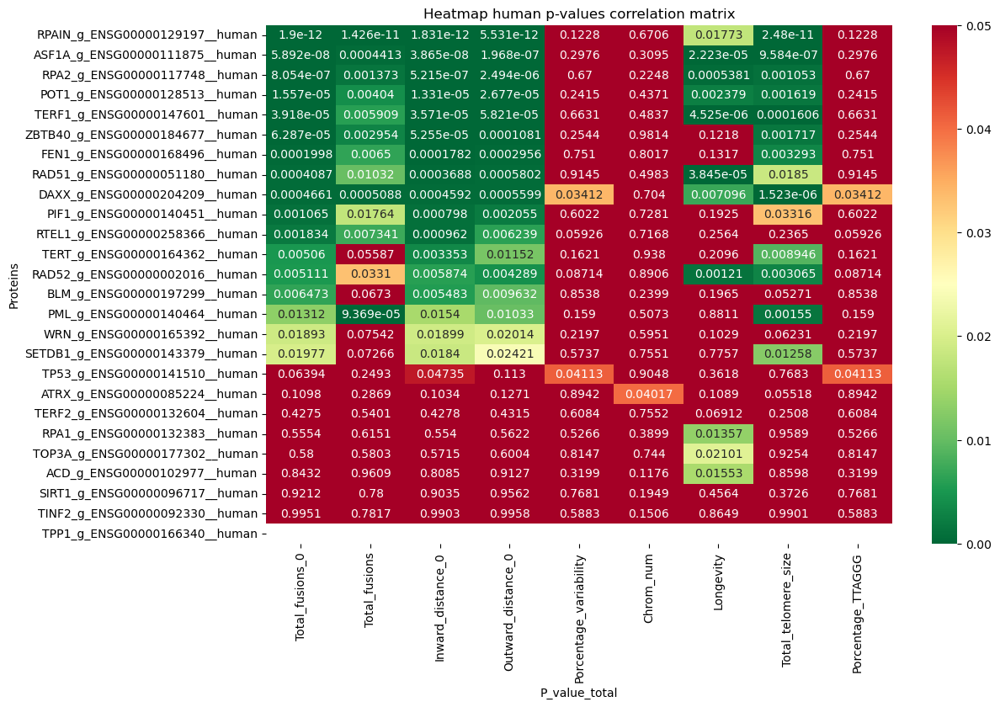

In [300]:
correlation_matrix_2_p_values = pd.read_excel('Correlation_matrix_fusions_p_value_human.xlsx', index_col='Unnamed: 0')
#correlation_matrix_2_p_values = pd.read_excel('Correlation_matrix_fusions_p_value_mouse.xlsx', index_col='Unnamed: 0')

correlation_matrix_2_p_values = correlation_matrix_2_p_values[correlation_matrix_2_p_values.index.str.contains('_g_')]
correlation_matrix_2_p_values.sort_values(by='Total_fusions_0', inplace=True)

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix_2_p_values, annot=True, cmap='RdYlGn_r', vmin=0, vmax=0.05, fmt=".4g")
plt.title('Heatmap human p-values correlation matrix')
plt.xlabel('P_value_total')
plt.ylabel('Proteins')
plt.show()

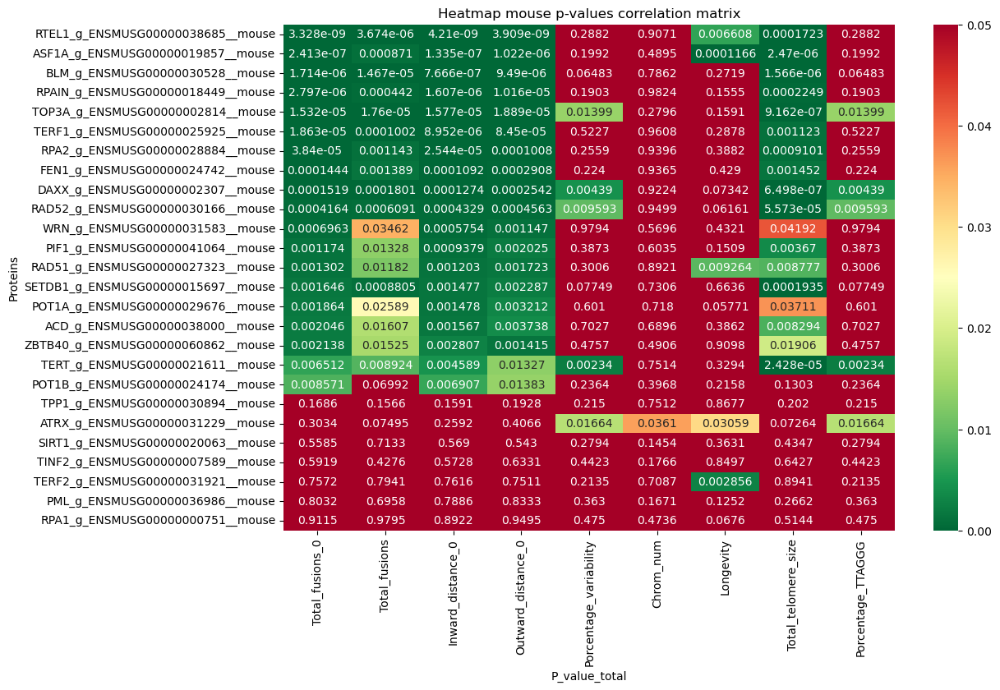

In [302]:

correlation_matrix_2_p_values = pd.read_excel('Correlation_matrix_fusions_p_value_mouse.xlsx', index_col='Unnamed: 0')

correlation_matrix_2_p_values = correlation_matrix_2_p_values[correlation_matrix_2_p_values.index.str.contains('_g_')]
correlation_matrix_2_p_values.sort_values(by='Total_fusions_0', inplace=True)

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix_2_p_values, annot=True, cmap='RdYlGn_r', vmin=0, vmax=0.05, fmt=".4g")
plt.title('Heatmap mouse p-values correlation matrix')
plt.xlabel('P_value_total')
plt.ylabel('Proteins')
plt.show()

In [22]:
columns = ['Unnamed: 0','Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
correlation_matrix = pd.read_excel('Correlation_matrix_fusions_mouse.xlsx', index_col='Unnamed: 0', usecols=columns)

def process_protein_name(name):
    return name.split('_')[0]

Detecting correaltions from different types of variables

MOUSE

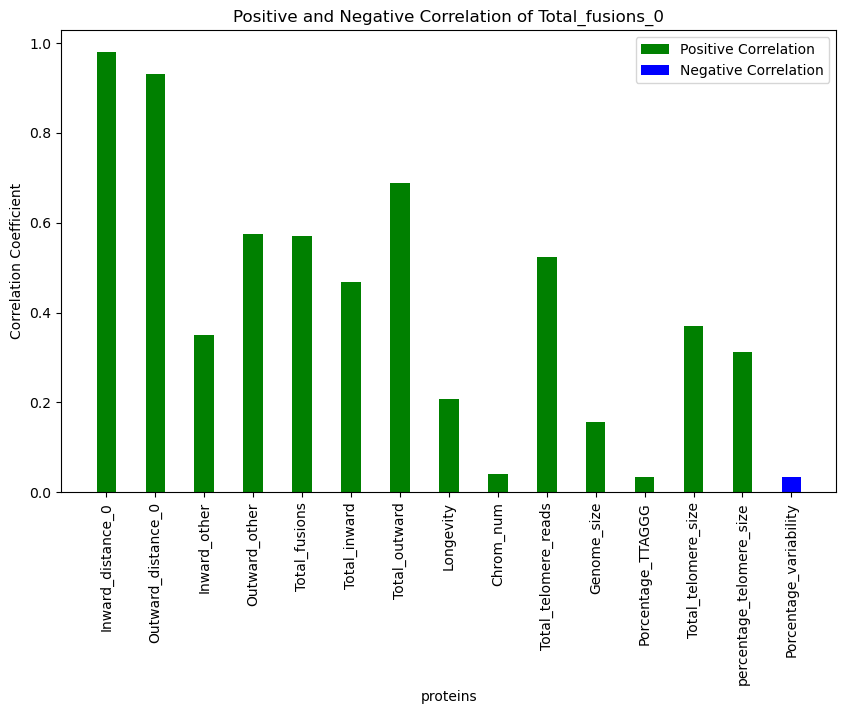

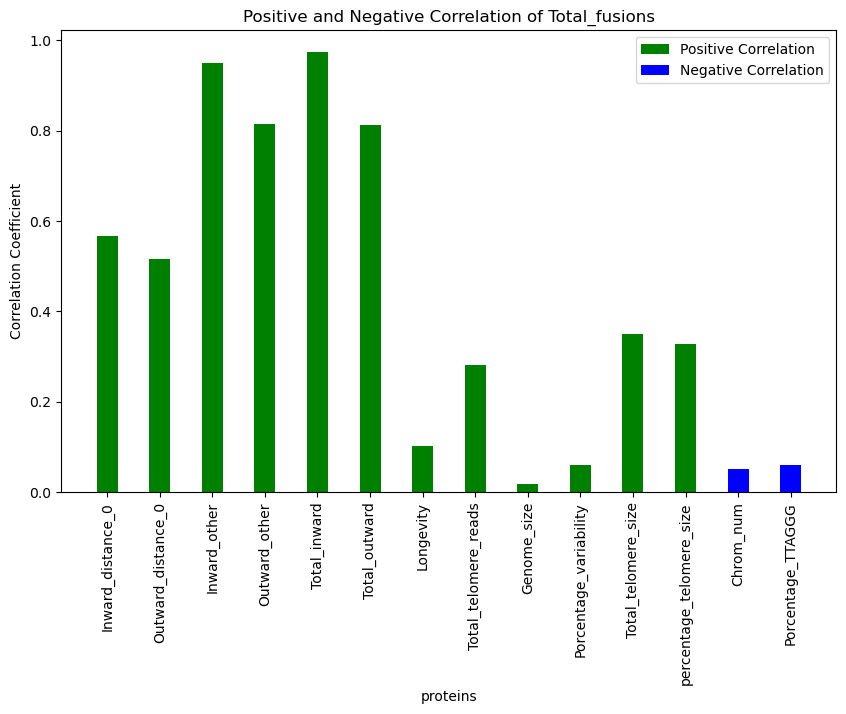

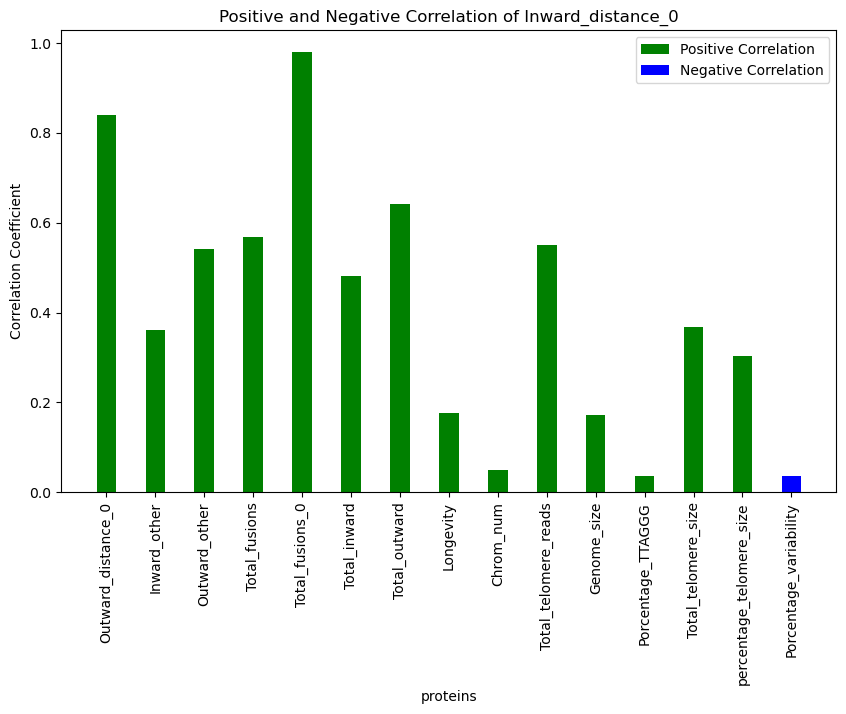

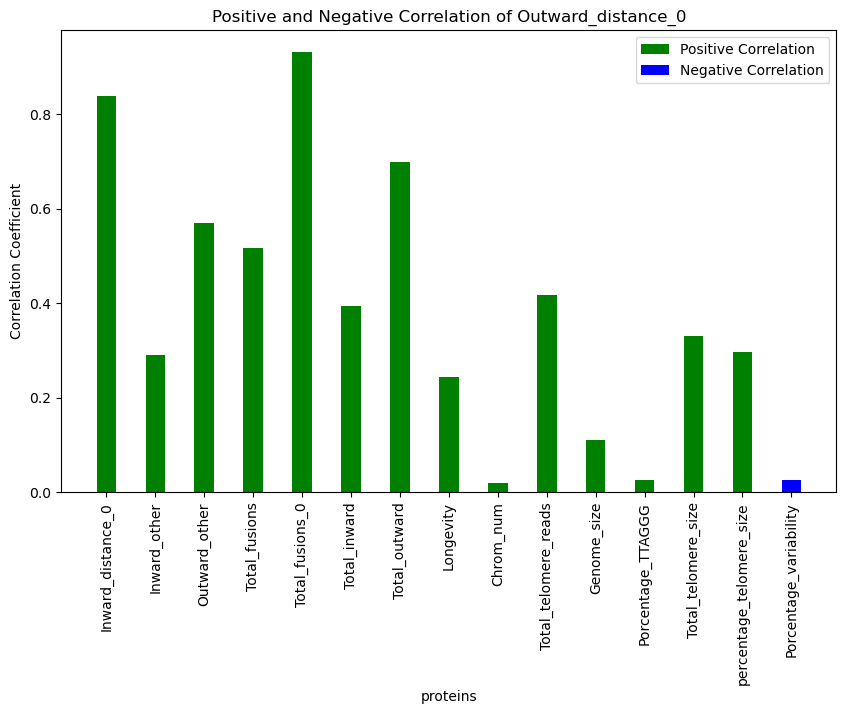

In [23]:
columns = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0']


for column in columns:

    correlation = correlation_matrix[column]
    correlation = correlation[~correlation.index.str.contains('_g_')]
    correlation = correlation[~correlation.index.str.contains(column)]
    
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]

    
    negative_correlation_abs = np.abs(negative_correlation)
    
    plt.figure(figsize=(10, 6))
    
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column}')
    plt.xlabel('proteins')
    plt.ylabel('Correlation Coefficient')
    plt.xticks(rotation=90)
    plt.legend()
    
    plt.show()

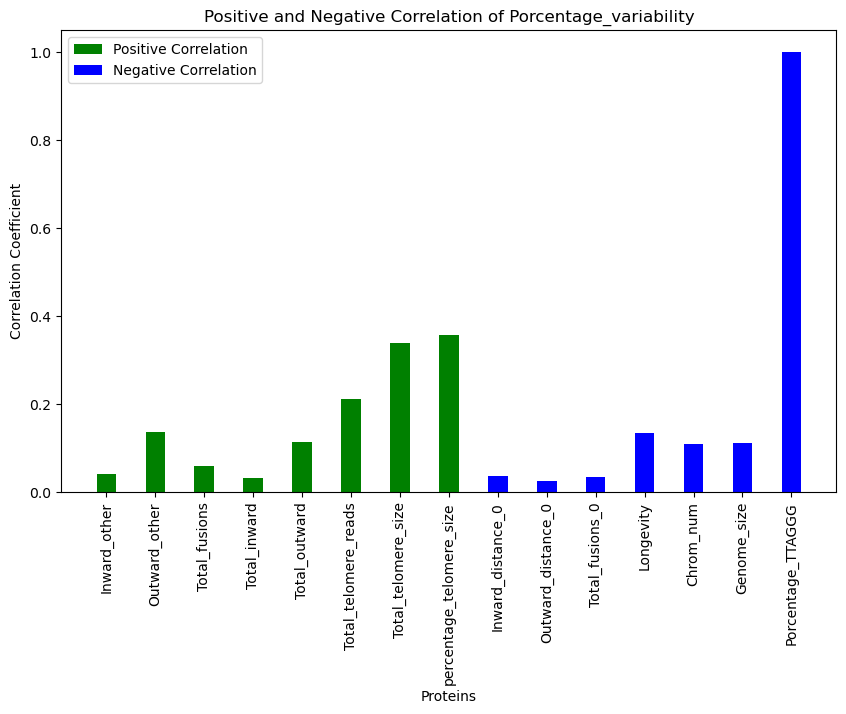

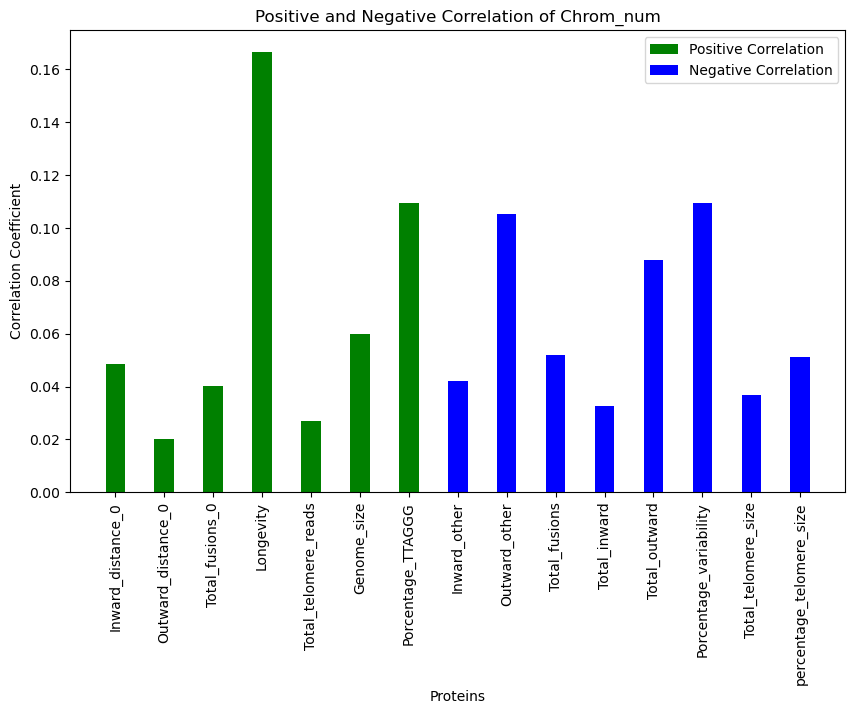

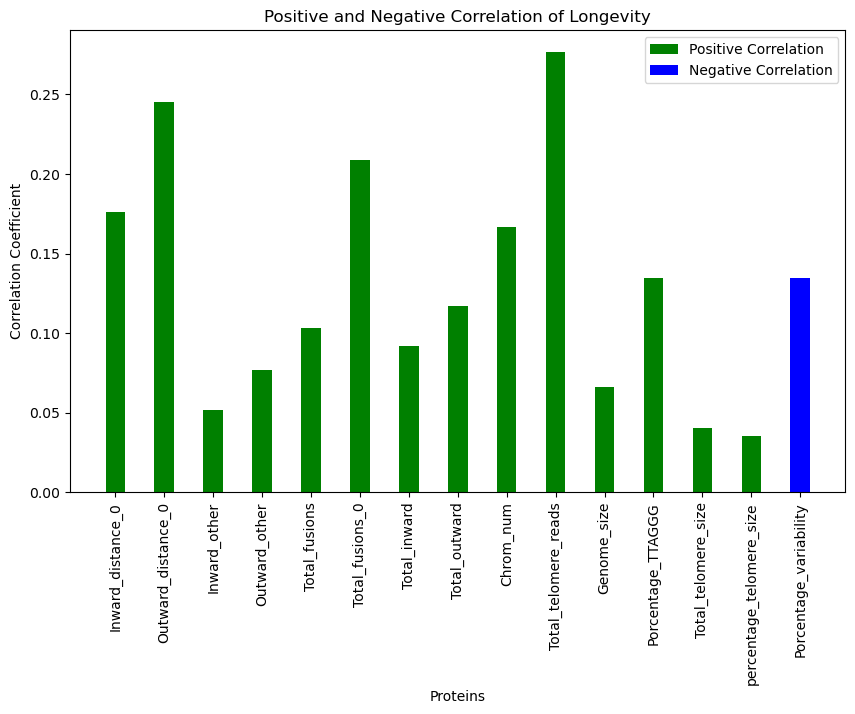

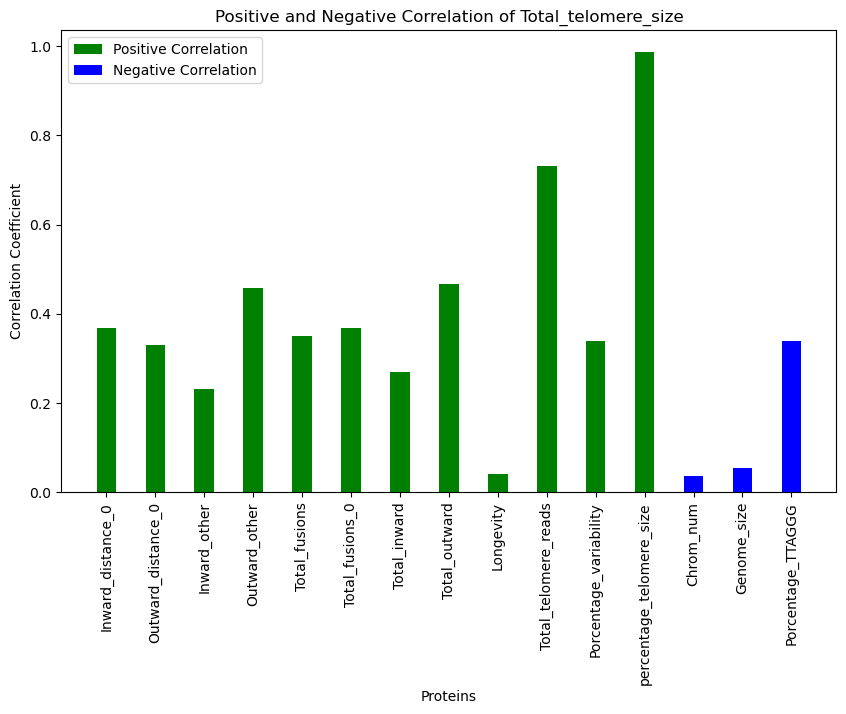

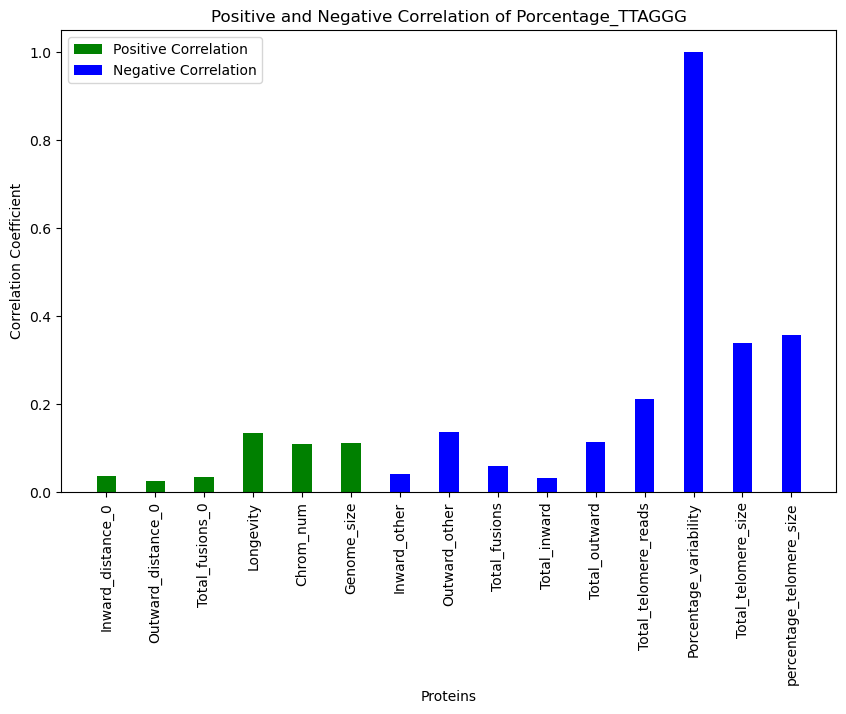

In [24]:
columns = ['Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

for column in columns:

    correlation = correlation_matrix[column]
    correlation = correlation[~correlation.index.str.contains('_g_')]
    correlation = correlation[~correlation.index.str.contains(column)]

    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    negative_correlation_abs = np.abs(negative_correlation)
    
    plt.figure(figsize=(10, 6))
    
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column}')
    plt.xlabel('Proteins')
    plt.ylabel('Correlation Coefficient')
    plt.xticks(rotation=90)
    plt.legend()
    
    plt.show()

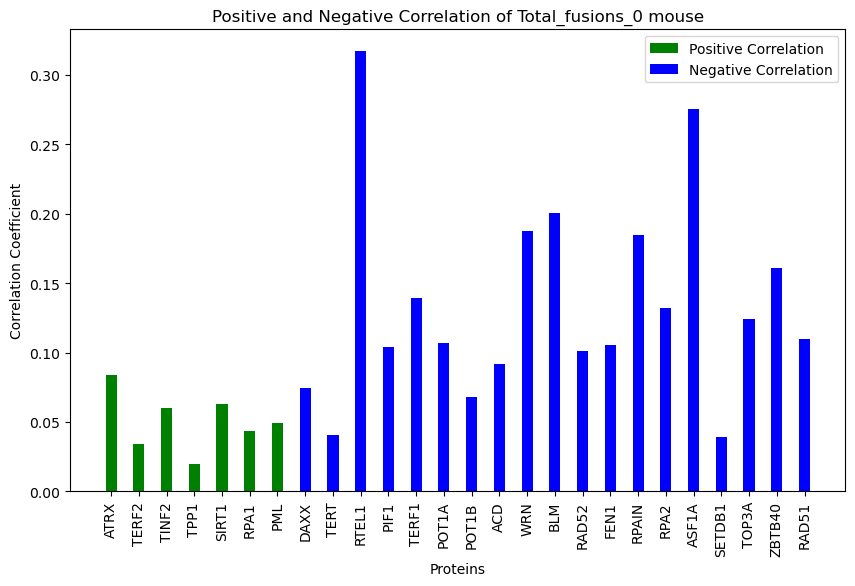

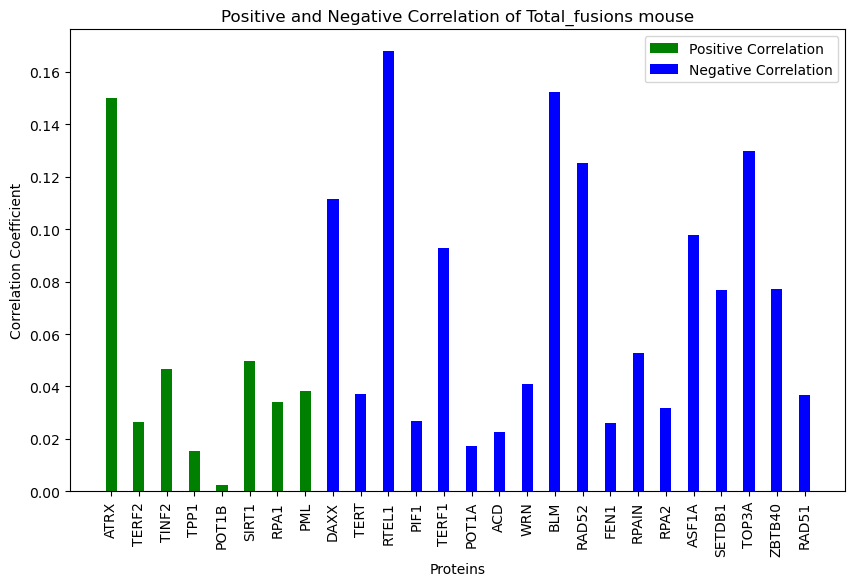

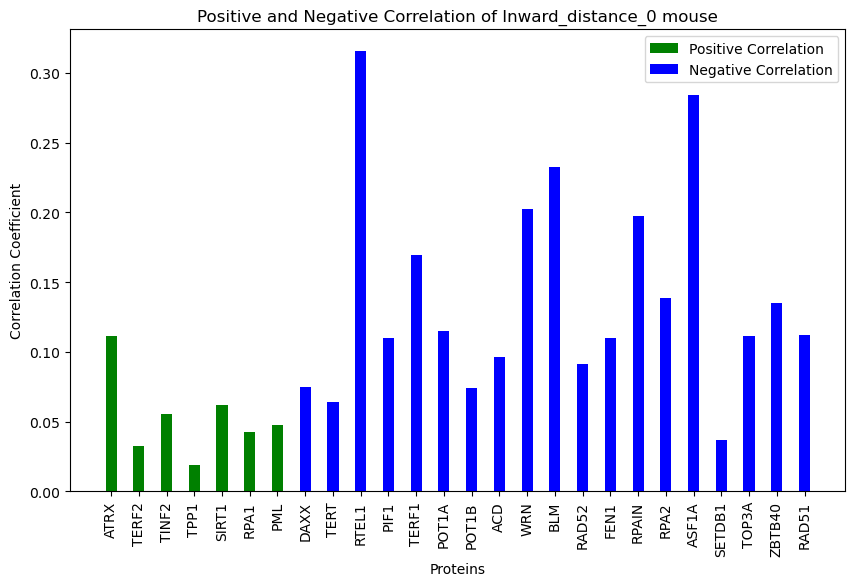

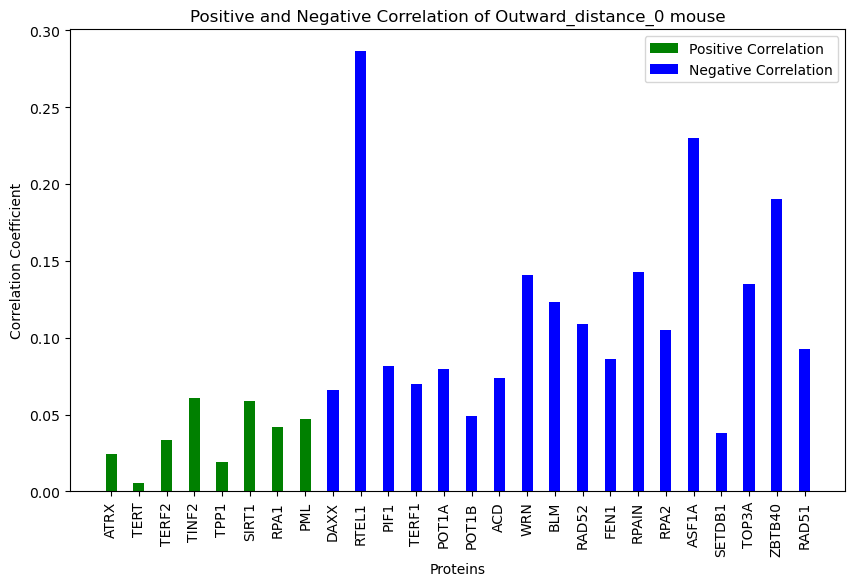

In [25]:

columns = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0']

for column in columns:
    correlation = correlation_matrix[column]
    
    correlation = correlation[correlation.index.str.contains('_g_')]
    
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    positive_correlation.index = positive_correlation.index.map(process_protein_name)
    negative_correlation.index = negative_correlation.index.map(process_protein_name)
    
    negative_correlation_abs = np.abs(negative_correlation)
    
    plt.figure(figsize=(10, 6))
    
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column} mouse')
    plt.xlabel('Proteins')
    plt.ylabel('Correlation Coefficient')
    plt.xticks(rotation=90)
    plt.legend()
    
    plt.show()

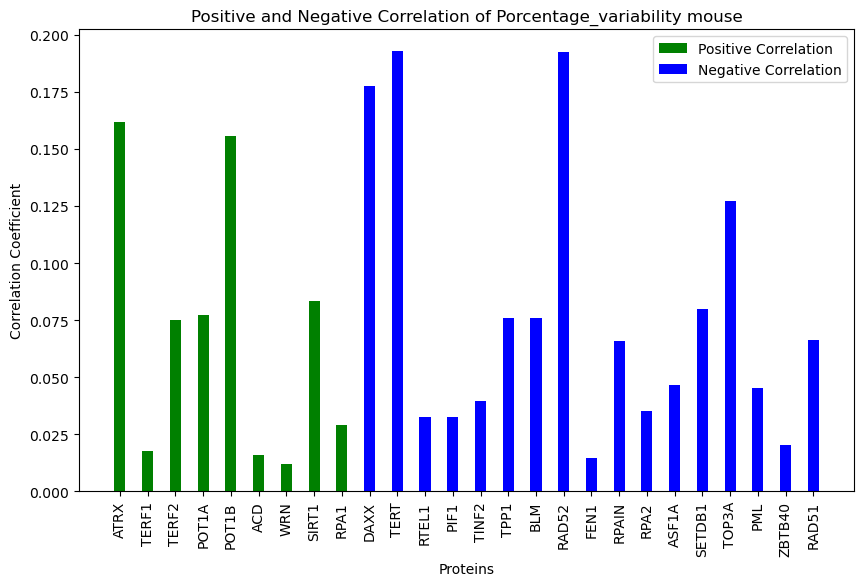

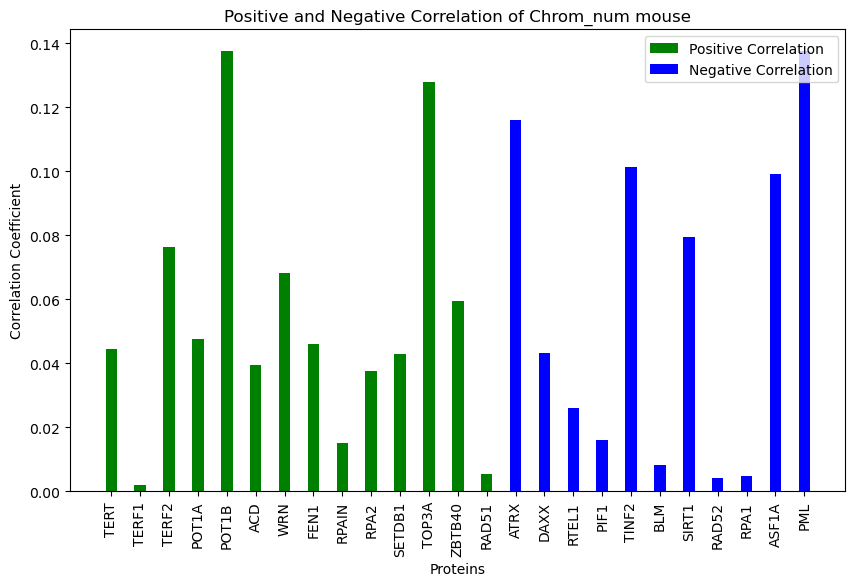

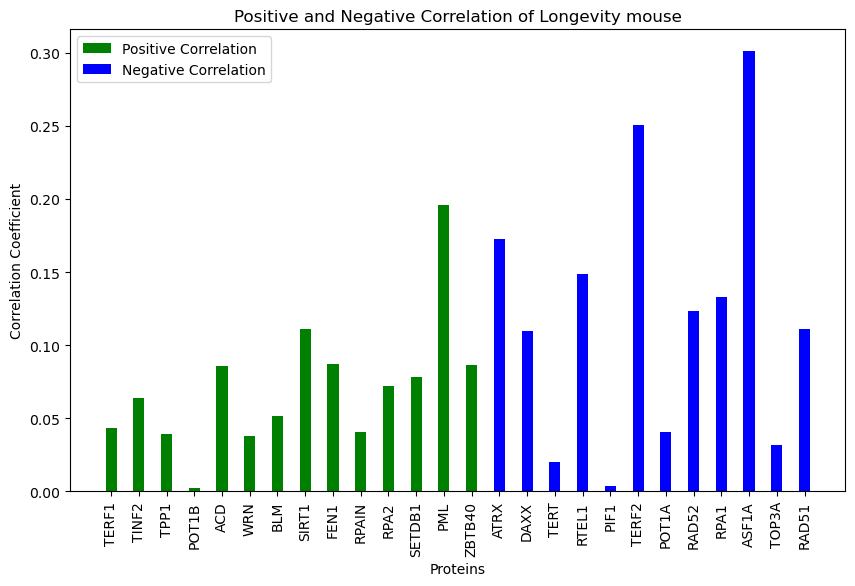

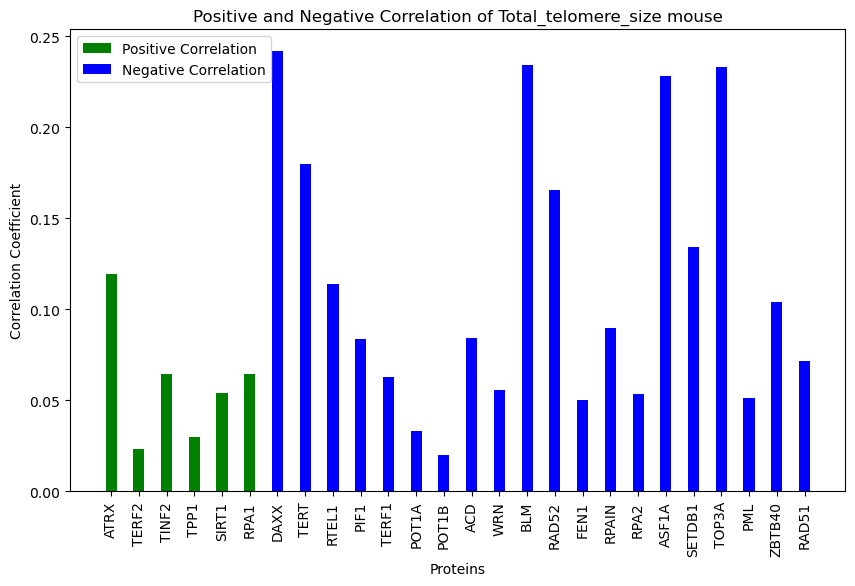

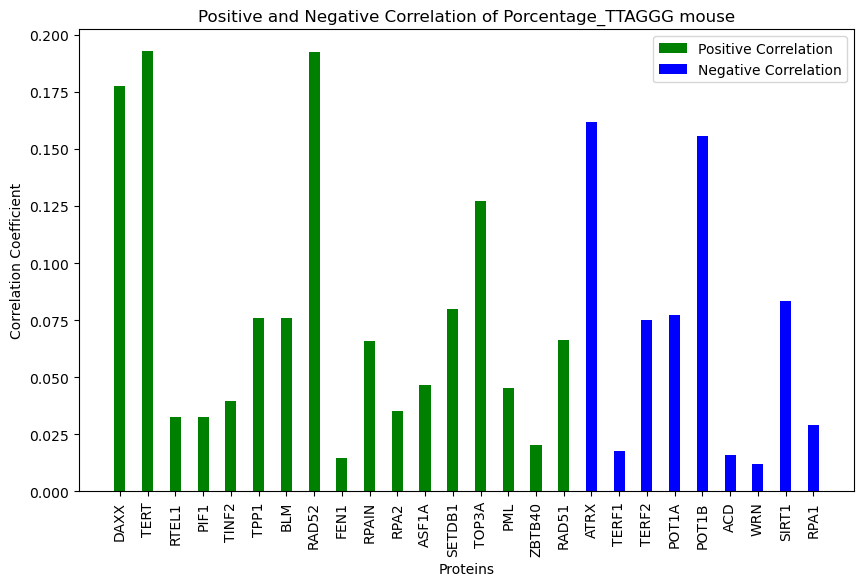

In [26]:
columns = ['Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

for column in columns:

    correlation = correlation_matrix[column]
    correlation = correlation[correlation.index.str.contains('_g_')]

    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    positive_correlation.index = positive_correlation.index.map(process_protein_name)
    negative_correlation.index = negative_correlation.index.map(process_protein_name)
    
    negative_correlation_abs = np.abs(negative_correlation)
    
    plt.figure(figsize=(10, 6))
    
    bar_width = 0.4  # Ancho de las barras
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column} mouse')
    plt.xlabel('Proteins')
    plt.ylabel('Correlation Coefficient')
    plt.xticks(rotation=90)
    plt.legend()
    
    plt.show()

HUMAN

In [27]:
columns = ['Unnamed: 0','Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
correlation_matrix = pd.read_excel('Correlation_matrix_fusions_human.xlsx', index_col='Unnamed: 0', usecols=columns)


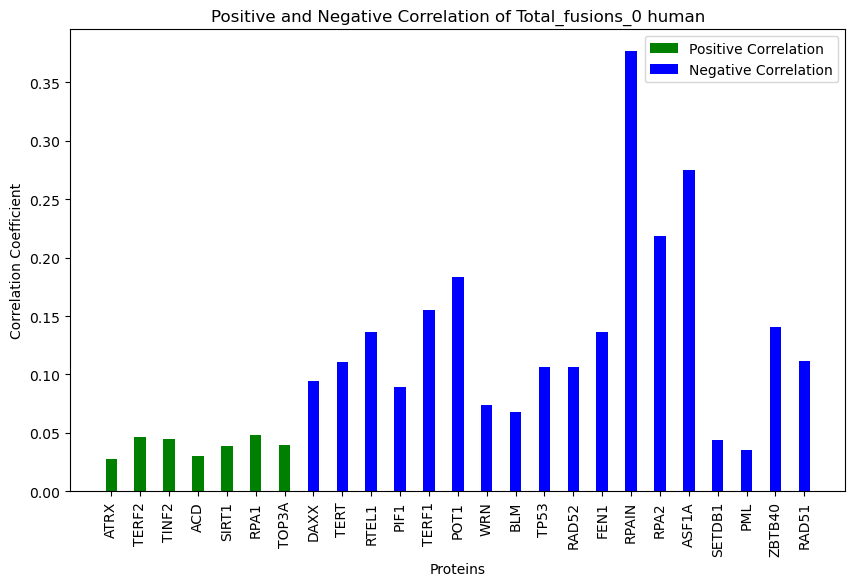

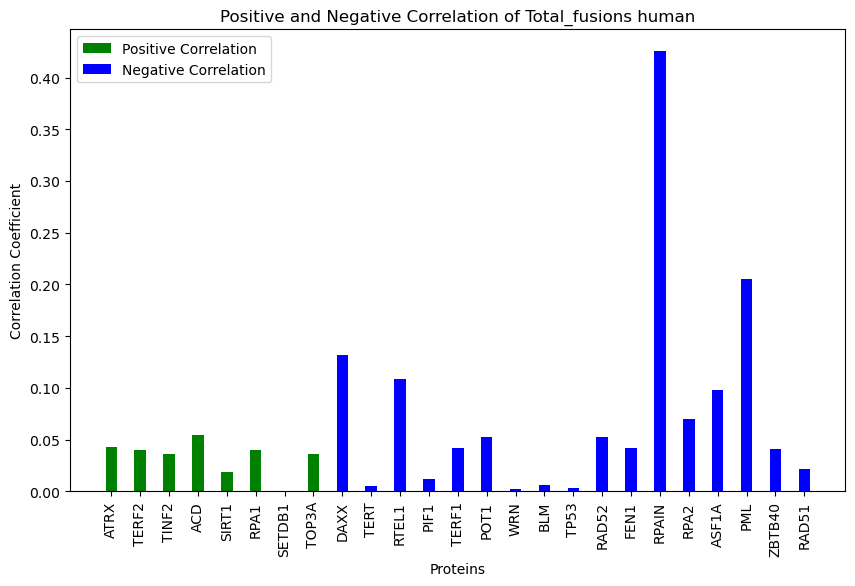

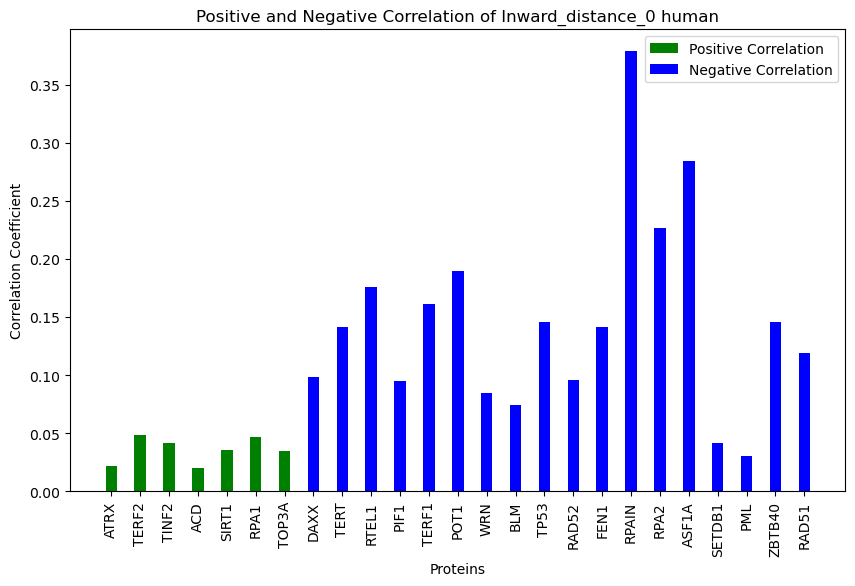

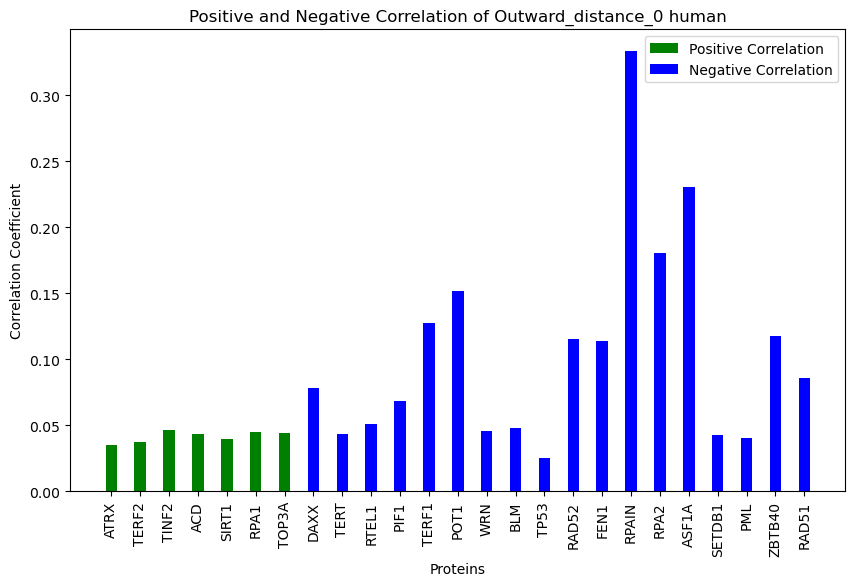

In [28]:
columns = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0']

for column in columns:
    correlation = correlation_matrix[column]
    
    correlation = correlation[correlation.index.str.contains('_g_')]
    
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    positive_correlation.index = positive_correlation.index.map(process_protein_name)
    negative_correlation.index = negative_correlation.index.map(process_protein_name)
        
    negative_correlation_abs = np.abs(negative_correlation)
    
    plt.figure(figsize=(10, 6))
    
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column} human')
    plt.xlabel('Proteins')
    plt.ylabel('Correlation Coefficient')
    plt.xticks(rotation=90)
    plt.legend()
    
    plt.show()

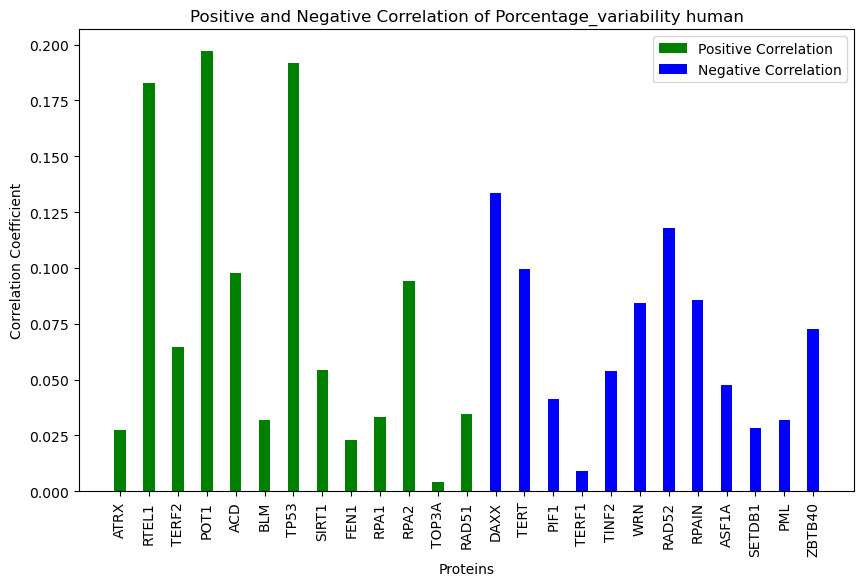

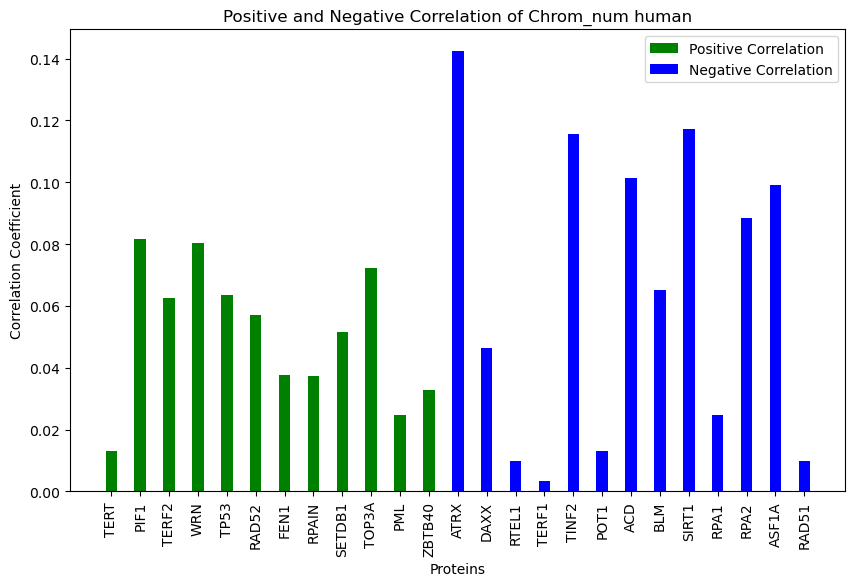

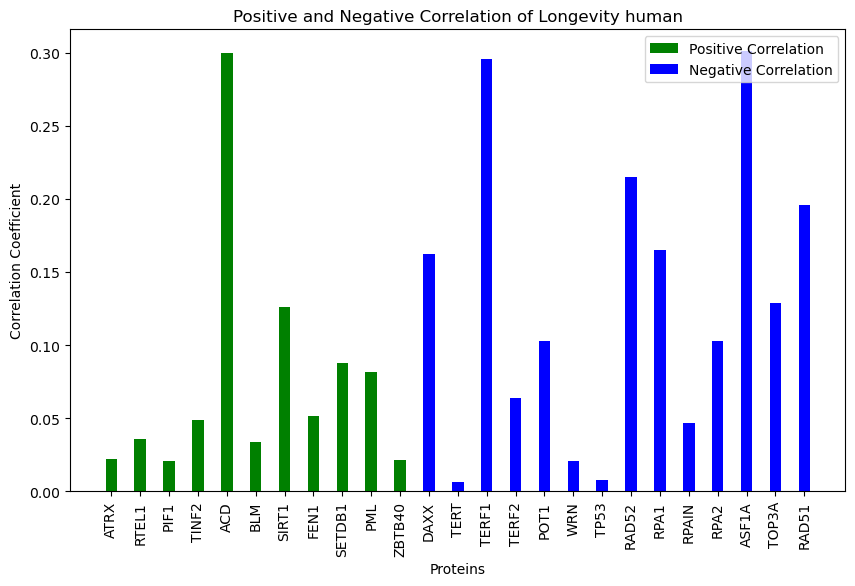

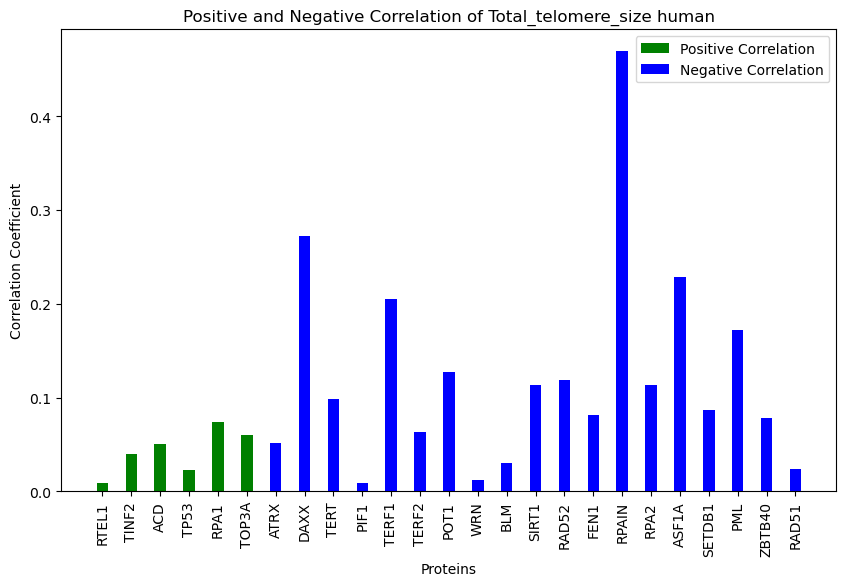

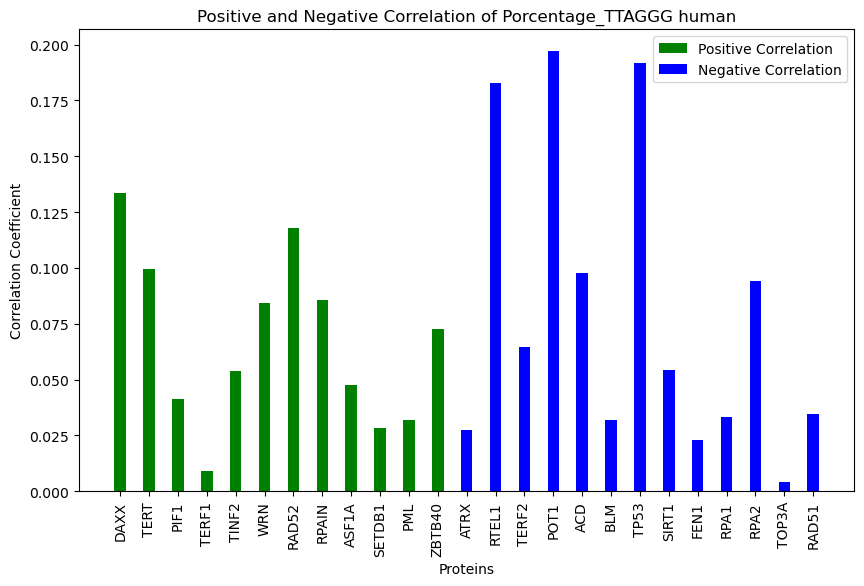

In [29]:
columns = ['Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

for column in columns:

    correlation = correlation_matrix[column]
    correlation = correlation[correlation.index.str.contains('_g_')]
    positive_correlation = correlation[correlation > 0]
    negative_correlation = correlation[correlation < 0]
    positive_correlation.index = positive_correlation.index.map(process_protein_name)
    negative_correlation.index = negative_correlation.index.map(process_protein_name)
    negative_correlation_abs = np.abs(negative_correlation)
    
    plt.figure(figsize=(10, 6))
    
    bar_width = 0.4  
    bars_positive = plt.bar(positive_correlation.index, positive_correlation, width=bar_width, color='green', align='center', label='Positive Correlation')
    bars_negative = plt.bar(negative_correlation_abs.index, negative_correlation_abs, width=bar_width, color='blue', align='center', label='Negative Correlation')
    
    plt.title(f'Positive and Negative Correlation of {column} human')
    plt.xlabel('Proteins')
    plt.ylabel('Correlation Coefficient')
    plt.xticks(rotation=90)
    plt.legend()
    
    plt.show()

Comparing Fusions vs fusions by order adding the correlation coeficient and the p-value of Kluskal Wallis

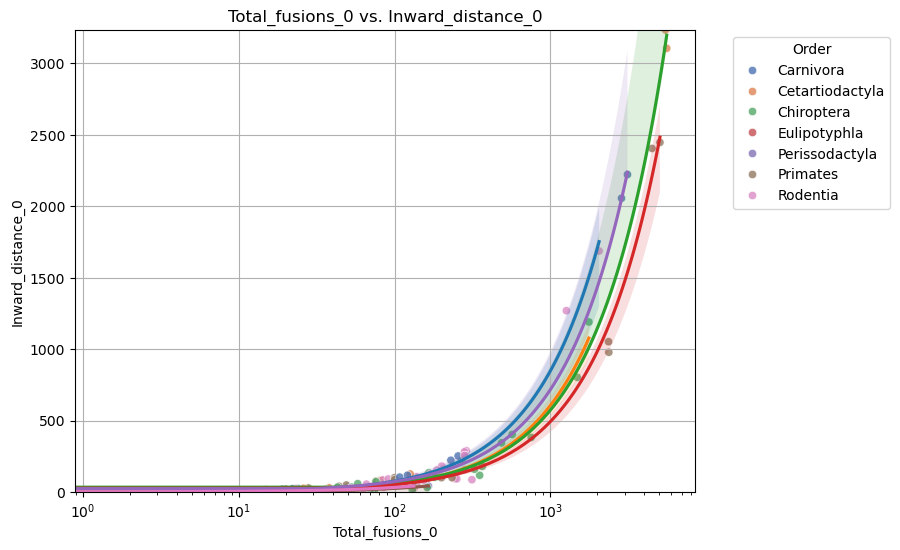

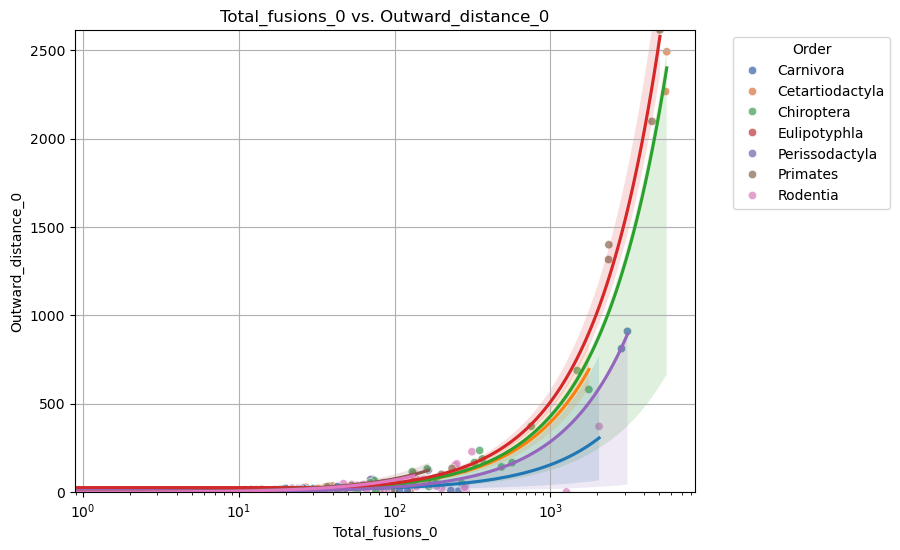

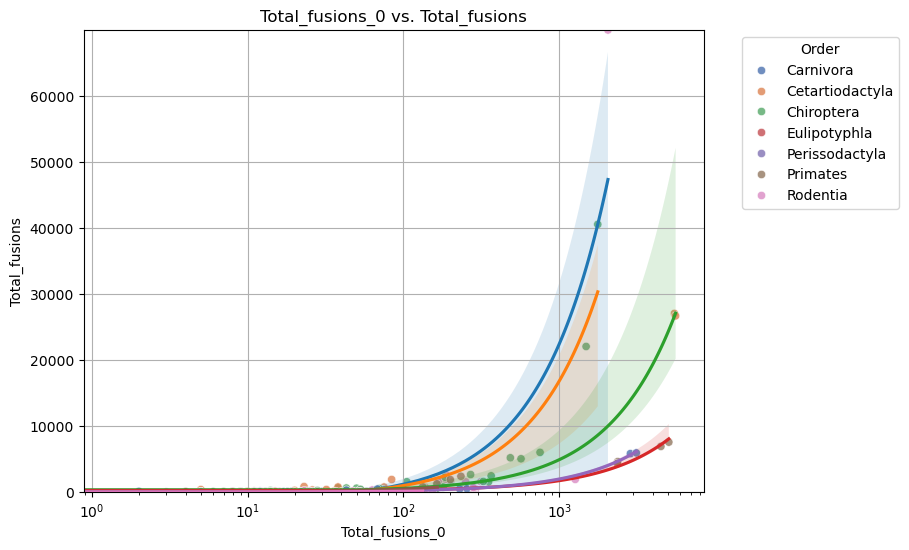

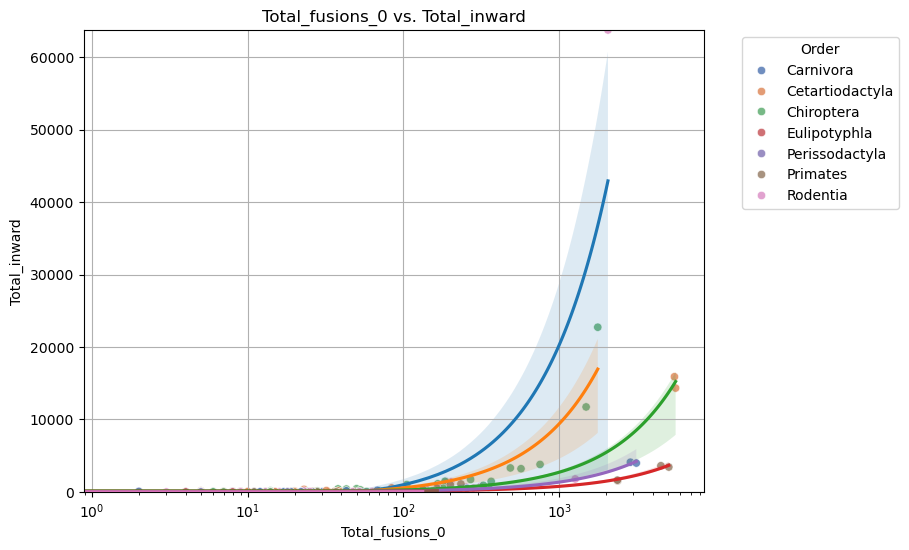

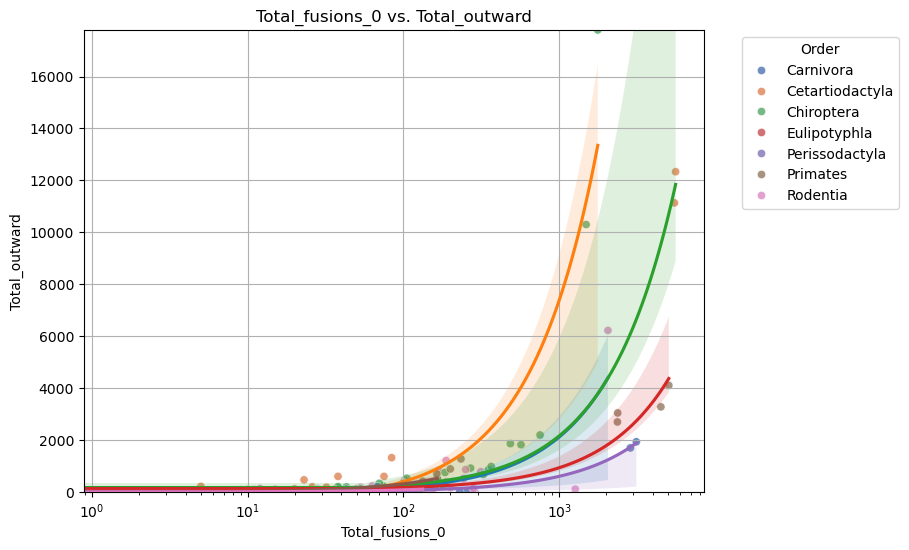

...

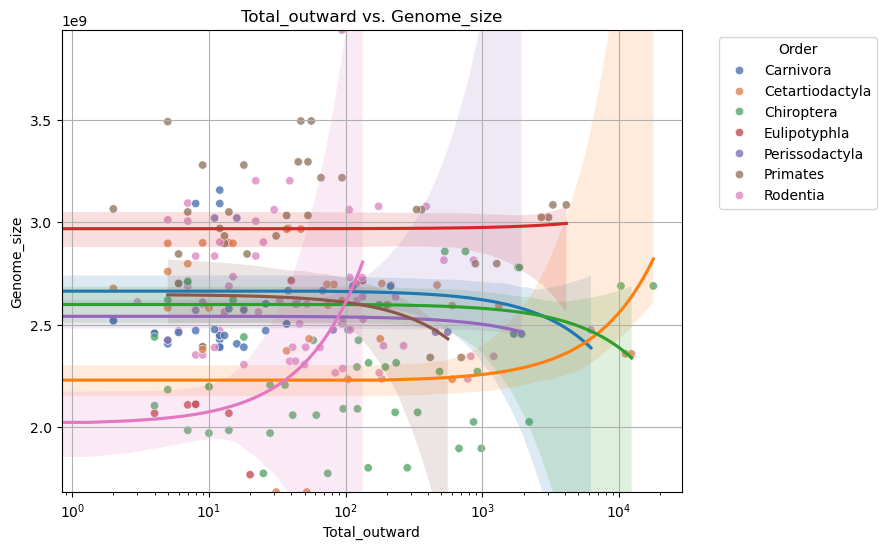

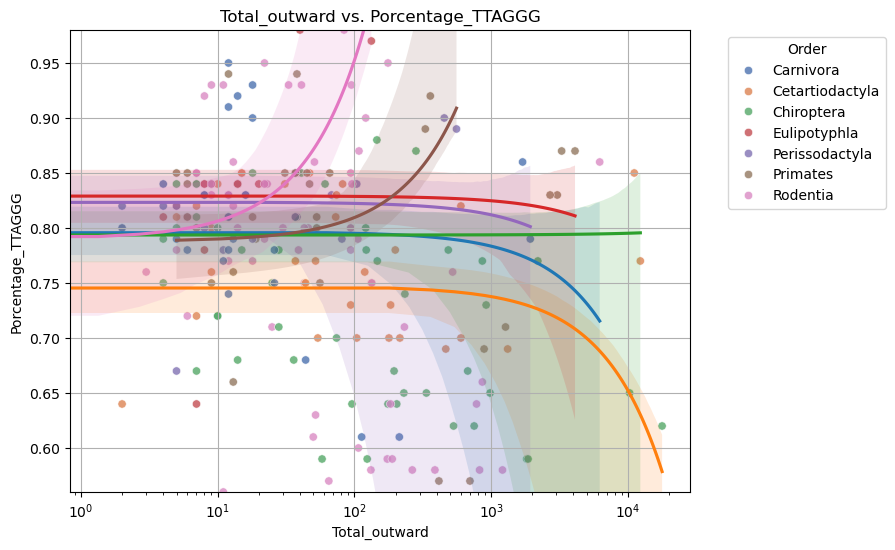

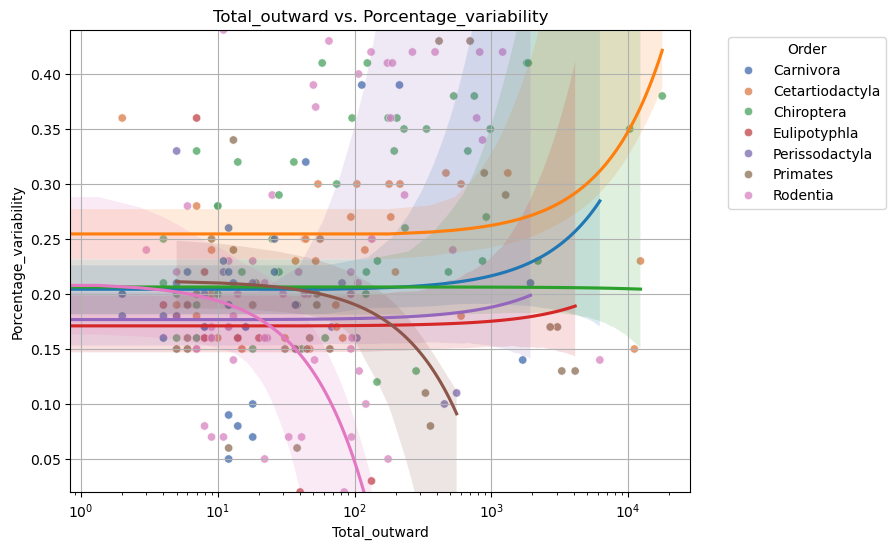

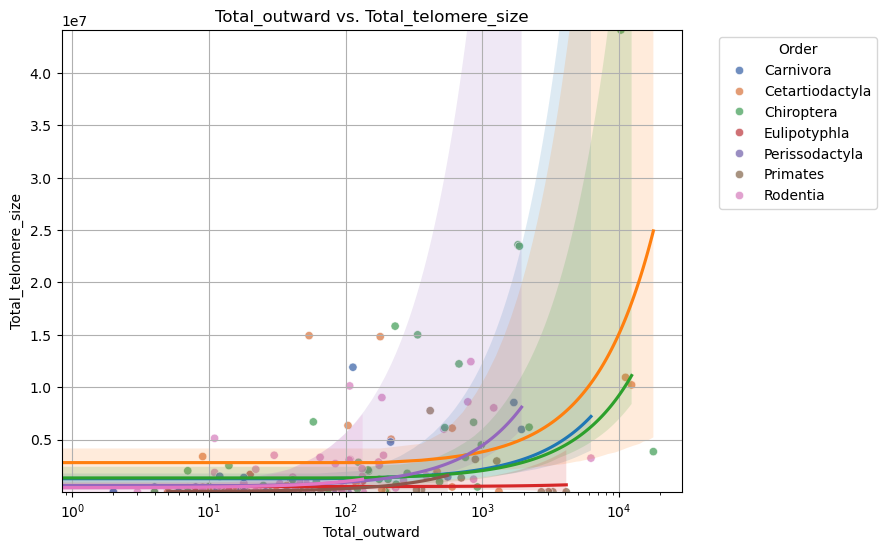

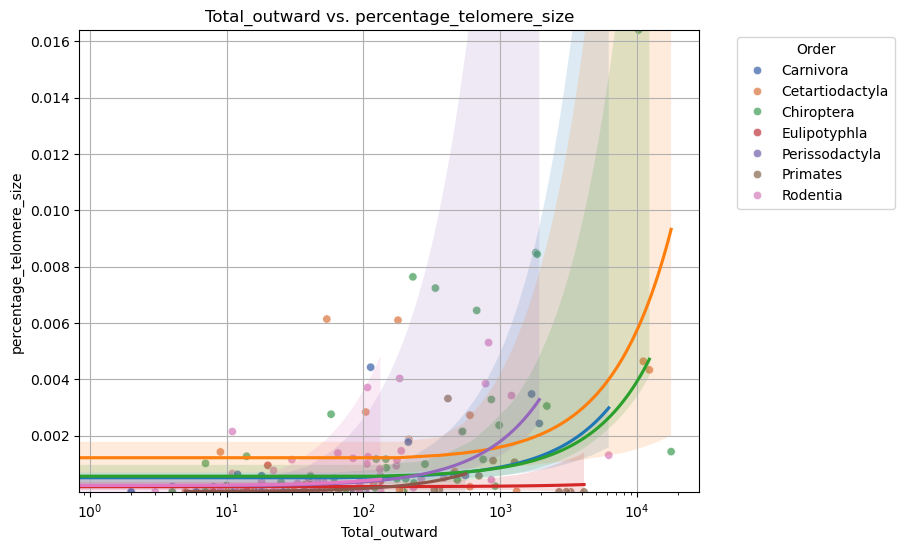

In [6]:


df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
df.drop(['Species_name', 'Species', 'Genome_coverage', 'Inward_other', 'Outward_other', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)
df = df.dropna(thresh=df.shape[1] - 4)

columns_interest = df.filter(like='_g_').columns
df2 = df.drop(columns_interest, axis=1)

order_counts = df2['Order'].value_counts()
valid_orders = order_counts[order_counts >= 10].index.tolist()

df2 = df2[df2['Order'].isin(valid_orders)]

df2['Order'] = df2['Order'].astype('category')

palette = sns.color_palette("tab10", len(valid_orders))
rows_of_study = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 'Total_inward', 'Total_outward']
           
for row_of_study in rows_of_study:
    for column in df2.columns:
        if column not in [row_of_study, 'Order']:
            plt.figure(figsize=(8, 6))
            
            sns.scatterplot(x=row_of_study, y=column, hue='Order', data=df2, alpha=0.8 , palette=palette_choice)
            
            for i, order in enumerate(valid_orders):
                df_order = df2[df2['Order'] == order]
                
                correlation = df_order[[row_of_study, column]].corr().iloc[0, 1]
                
                sns.regplot(x=row_of_study, y=column, data=df_order, scatter=False, color=palette[i], line_kws={'label': f'Order {order} (Correlation: {correlation:.2f})'})
            plt.xlabel(row_of_study)
            plt.ylabel(column)
            plt.title(f'{row_of_study} vs. {column}')
            plt.grid(True)

            plt.xscale('log')

            plt.ylim(df2[column].min(), df2[column].max())
            
            plt.legend(title='Order', bbox_to_anchor=(1.05, 1), loc='upper left')

            plt.show()


Comparing variability vs fusions by orden adding the correlation coeficient and the p-value of Kluskal Wallis

In [ ]:
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
df.drop(['Species_name', 'Species', 'Genome_coverage', 'Inward_other', 'Outward_other', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)
df = df.dropna(thresh=df.shape[1] - 4)

columns_interest = df.filter(like='_g_').columns
df2 = df.drop(columns_interest, axis=1)

order_counts = df2['Order'].value_counts()
valid_orders = order_counts[order_counts >= 10].index.tolist()

df2 = df2[df2['Order'].isin(valid_orders)]

df2['Order'] = df2['Order'].astype('category')

palette = sns.color_palette("tab10", len(valid_orders))
rows_of_study = ['Porcentage_variability', 'Chrom_num', 
            'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']
           
for row_of_study in rows_of_study:
    for column in df2.columns:
        if column not in [row_of_study, 'Order']:
            plt.figure(figsize=(8, 6))
            
            sns.scatterplot(x=row_of_study, y=column, hue='Order', data=df2, alpha=0.8 , palette=palette_choice)
            
            for i, order in enumerate(valid_orders):

                df_order = df2[df2['Order'] == order]
                correlation = df_order[[row_of_study, column]].corr().iloc[0, 1]
                
                sns.regplot(x=row_of_study, y=column, data=df_order, scatter=False, color=palette[i], line_kws={'label': f'Order {order} (Correlation: {correlation:.2f})'})
            plt.xlabel(row_of_study)
            plt.ylabel(column)
            plt.title(f'{row_of_study} vs. {column}')
            plt.grid(True)

            #plt.xscale('log')

            plt.ylim(df2[column].min(), df2[column].max())
            
            plt.legend(title='Order', bbox_to_anchor=(1.05, 1), loc='upper left')

            plt.show()


Comparing proteins vs fusions

Mouse

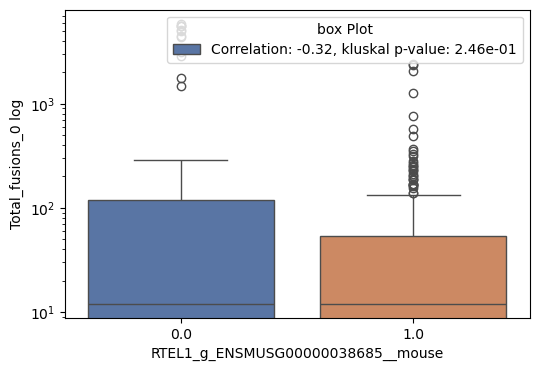

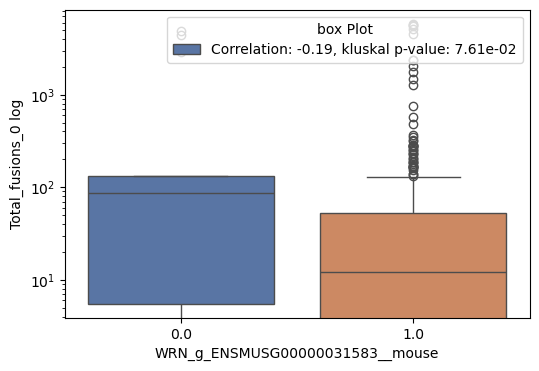

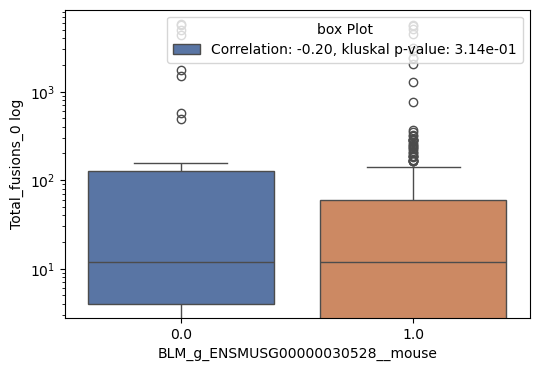

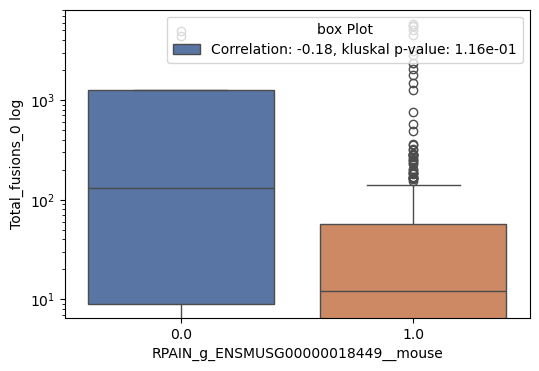

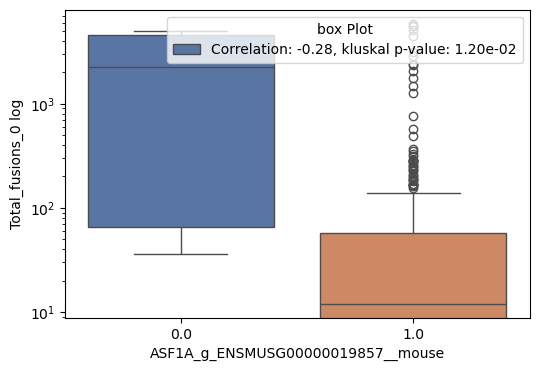

...

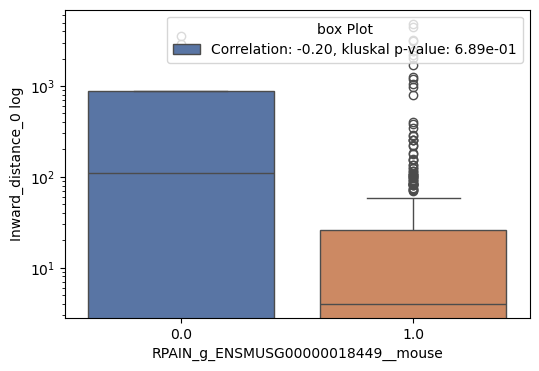

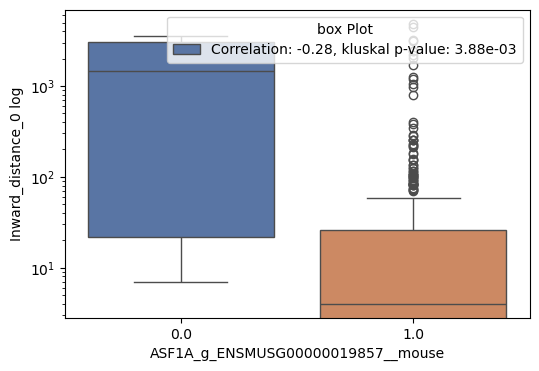

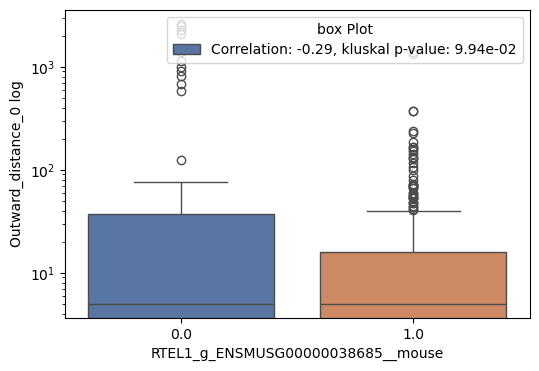

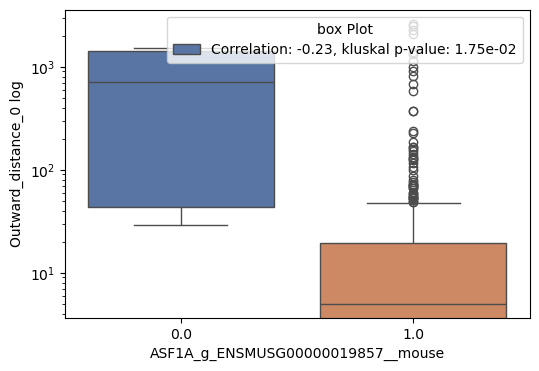

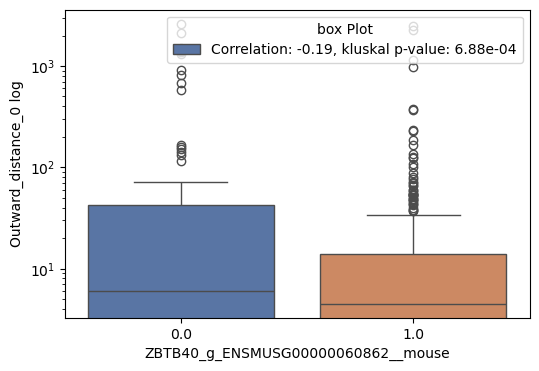

In [26]:

df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
columns_interest = df.filter(like='_g_').columns

df = df.dropna(thresh=df.shape[1] - 2)

columns_2 = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0']

result_df = pd.read_excel('kruskal_mouse_p_values.xlsx', index_col=0)

std_devs = df[columns_interest].std()
valid_columns = std_devs[std_devs > 0].index

for column_2 in columns_2:
    
    correlations = df[valid_columns].corrwith(df[column_2])

    correlation_threshold = 0.17

    interesting_columns = correlations[abs(correlations) >= correlation_threshold].index

    palette_choice = 'deep'

    for column in interesting_columns:
        plt.figure(figsize=(6, 4))
        
        sns.boxplot(x=column, y=column_2, data=df, hue=column, palette=palette_choice, legend=False)
        
        corr_value = correlations[column]

        legend_labels = []
        
        if column in result_df.index and column_2 in result_df.columns:
            p_value = result_df.loc[column, column_2]
            legend_labels.append(f'Correlation: {corr_value:.2f}, kluskal p-value: {p_value:.2e}')
        else:
            legend_labels.append(f'Correlation: {corr_value:.2f}')
        
        plt.legend(title='box Plot', labels=legend_labels, loc='upper right')
        plt.ylabel(column_2 +' log')
        plt.yscale('log')
        
        plt.show()

Human

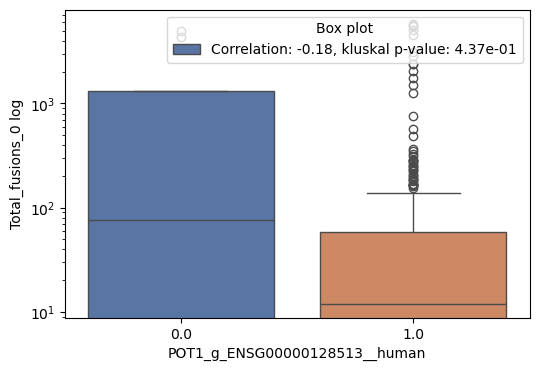

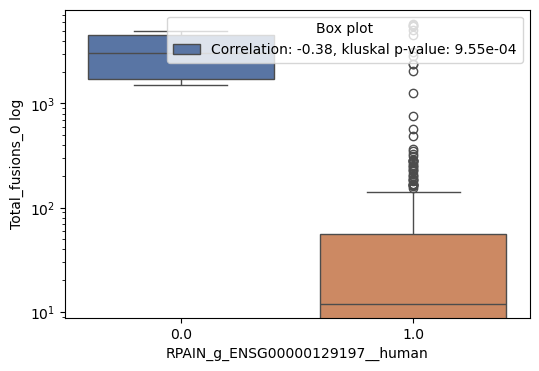

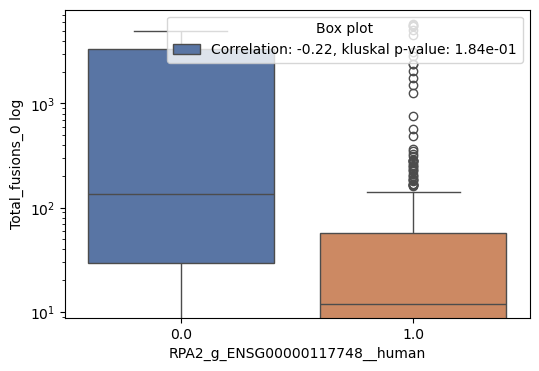

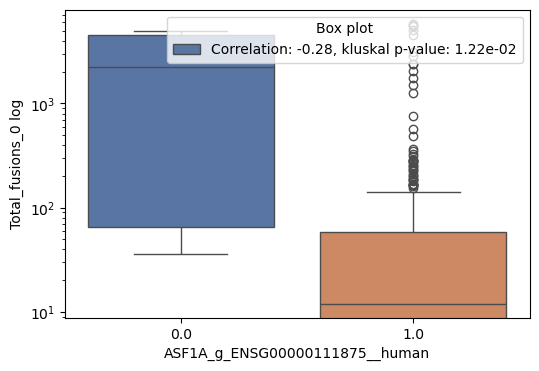

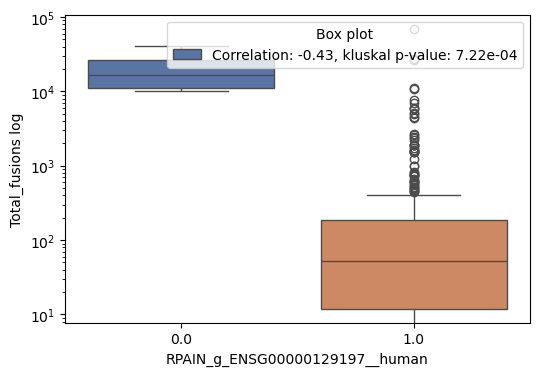

...

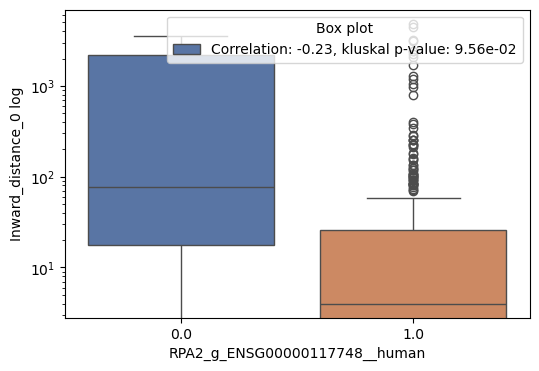

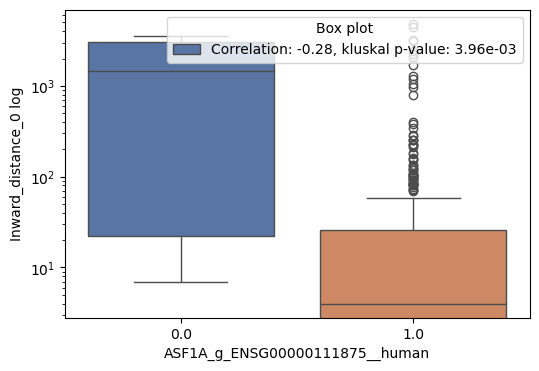

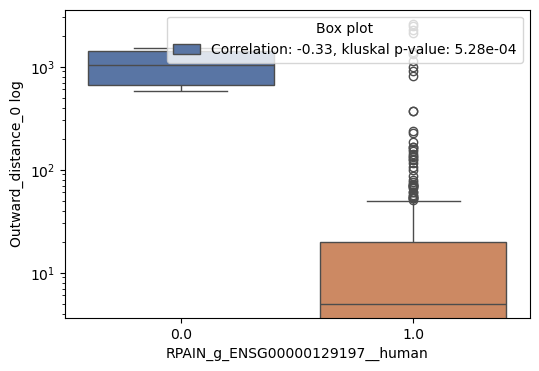

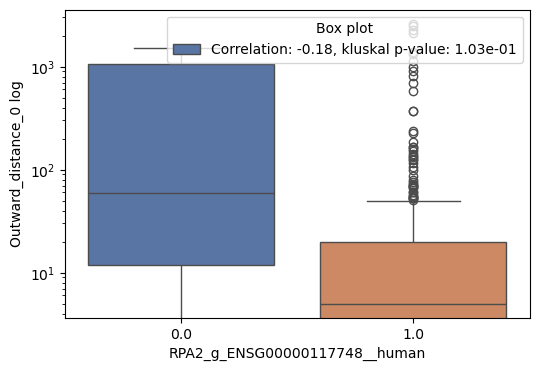

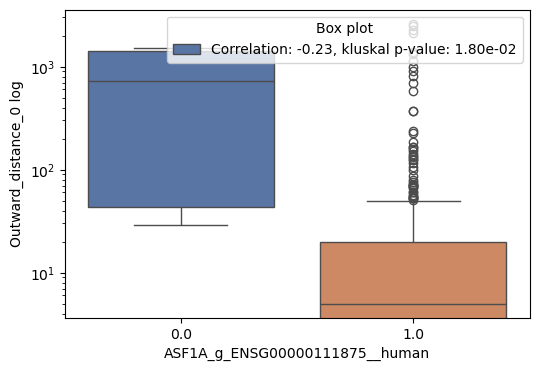

In [6]:
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
df = df.drop(['CMR', 'ICM'], axis = 1)
columns_interest = df.filter(like='_g_').columns

df = df.dropna(thresh=df.shape[1] - 2)

columns_2 = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0']

result_df = pd.read_excel('kruskal_human_p_values.xlsx', index_col=0)

std_devs = df[columns_interest].std()
valid_columns = std_devs[std_devs > 0].index

for column_2 in columns_2:
    correlations = df[valid_columns].corrwith(df[column_2])

    correlation_threshold = 0.18

    interesting_columns = correlations[abs(correlations) >= correlation_threshold].index

    palette_choice = 'deep'

    for column in interesting_columns:
        plt.figure(figsize=(6, 4))
        
        sns.boxplot(x=column, y=column_2, data=df, hue=column, palette=palette_choice, legend=False)
        
        corr_value = correlations[column]

        legend_labels = []
        
        if column in result_df.index and column_2 in result_df.columns:
            p_value = result_df.loc[column, column_2]
            legend_labels.append(f'Correlation: {corr_value:.2f}, kluskal p-value: {p_value:.2e}')
        else:
            legend_labels.append(f'Correlation: {corr_value:.2f}')
        
        plt.legend(title='Box plot', labels=legend_labels, loc='upper right')
        
        plt.xlabel(column)
        plt.ylabel(column_2 +' log')
        plt.yscale('log')
        
        plt.show()


comparing fusions vs order boxplot

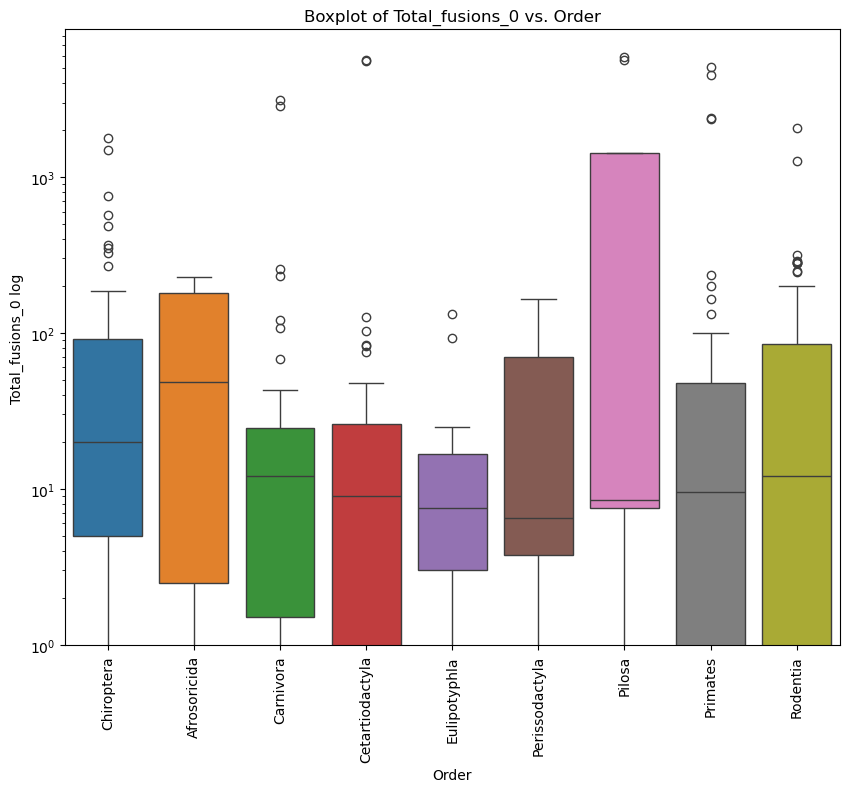

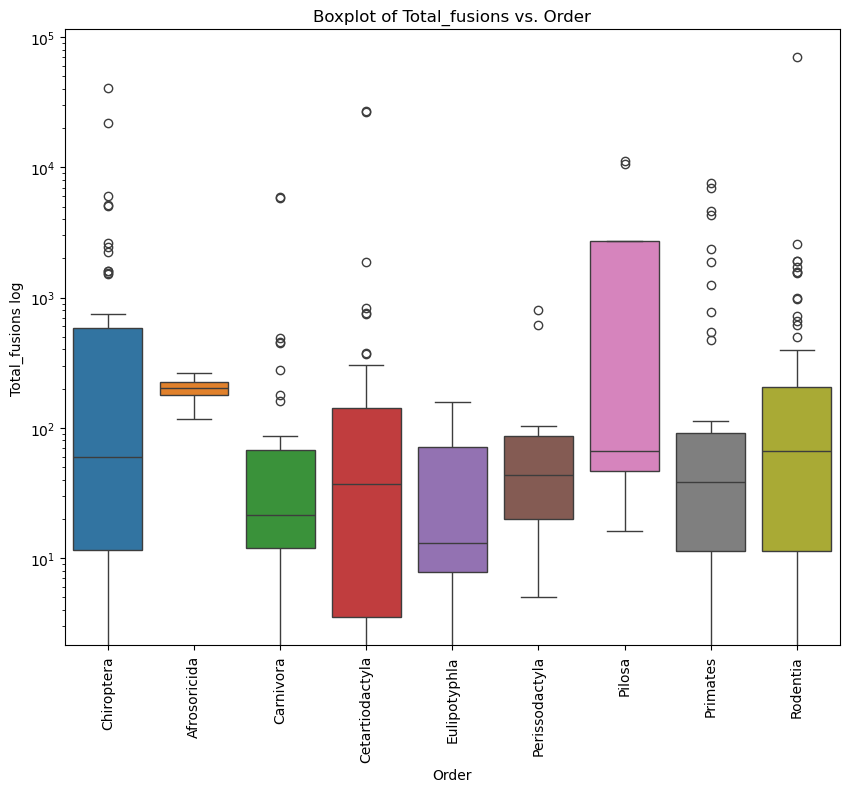

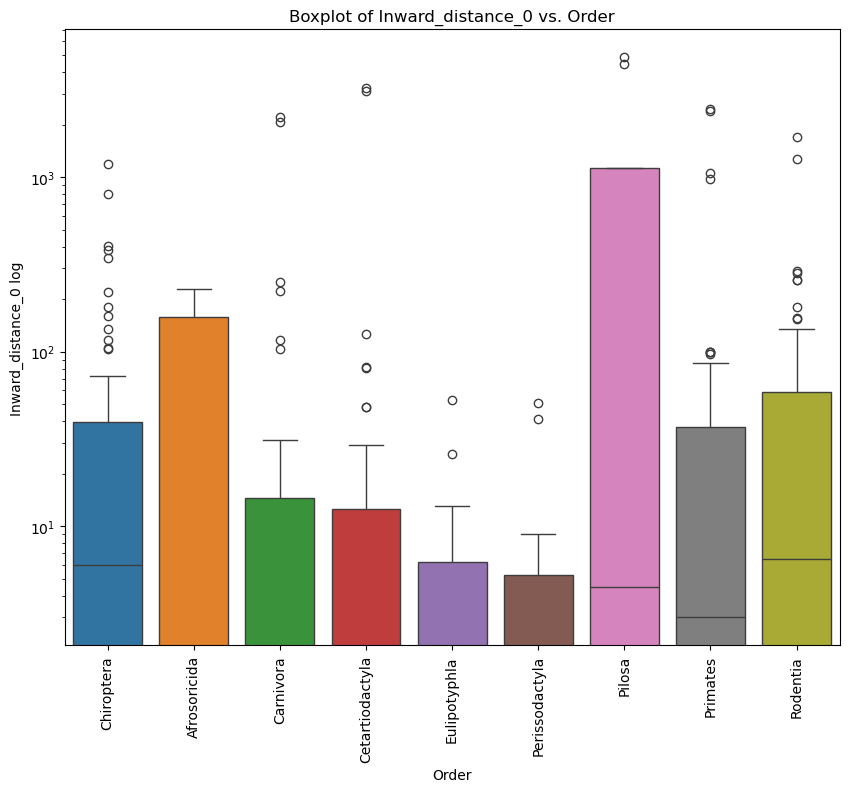

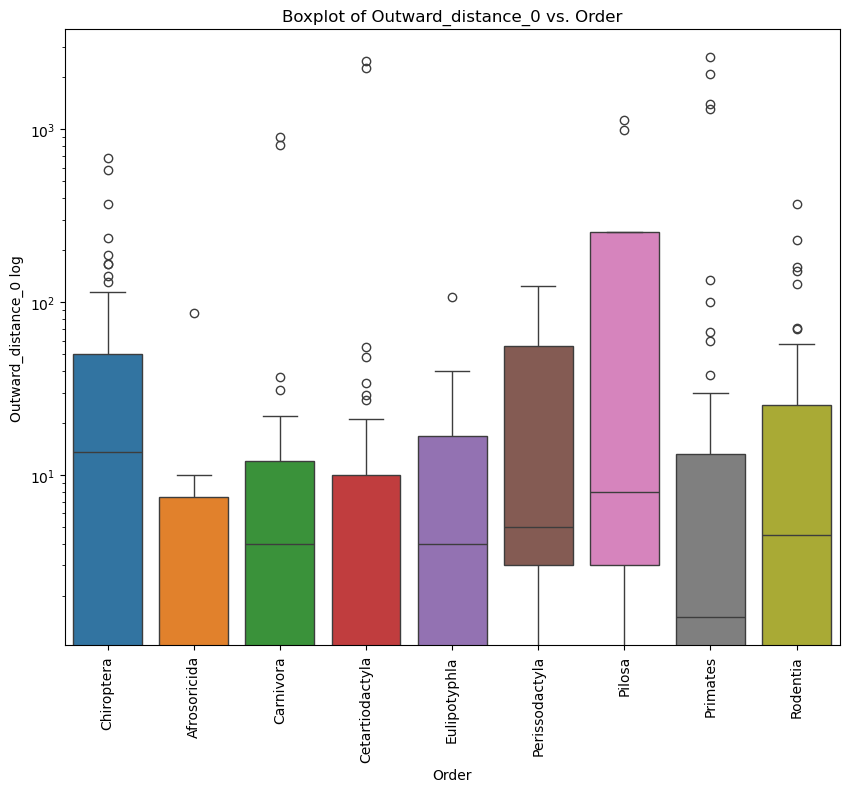

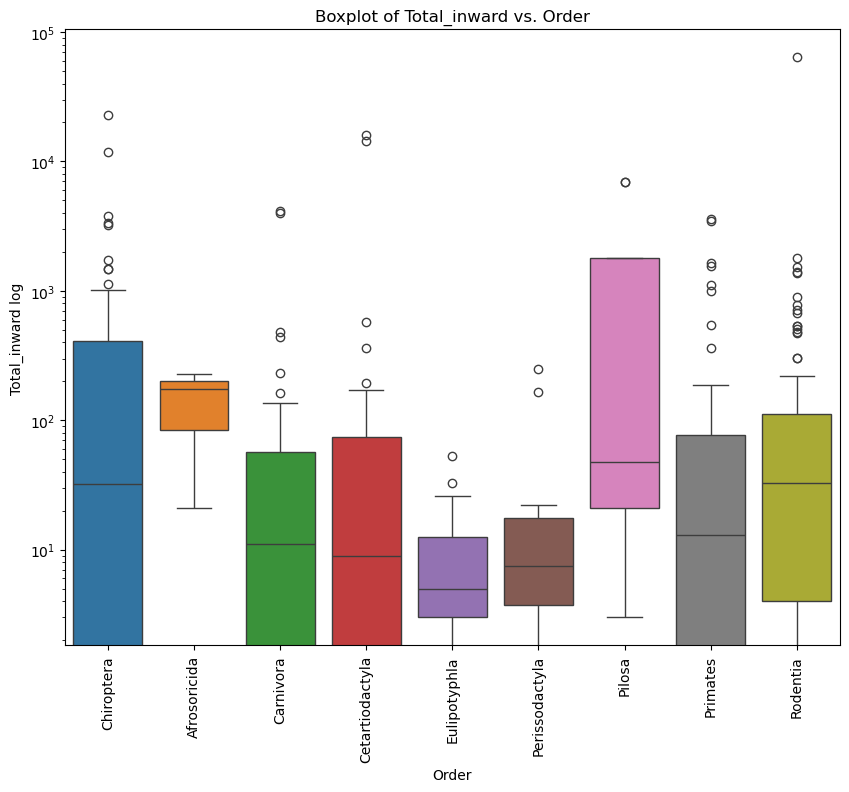

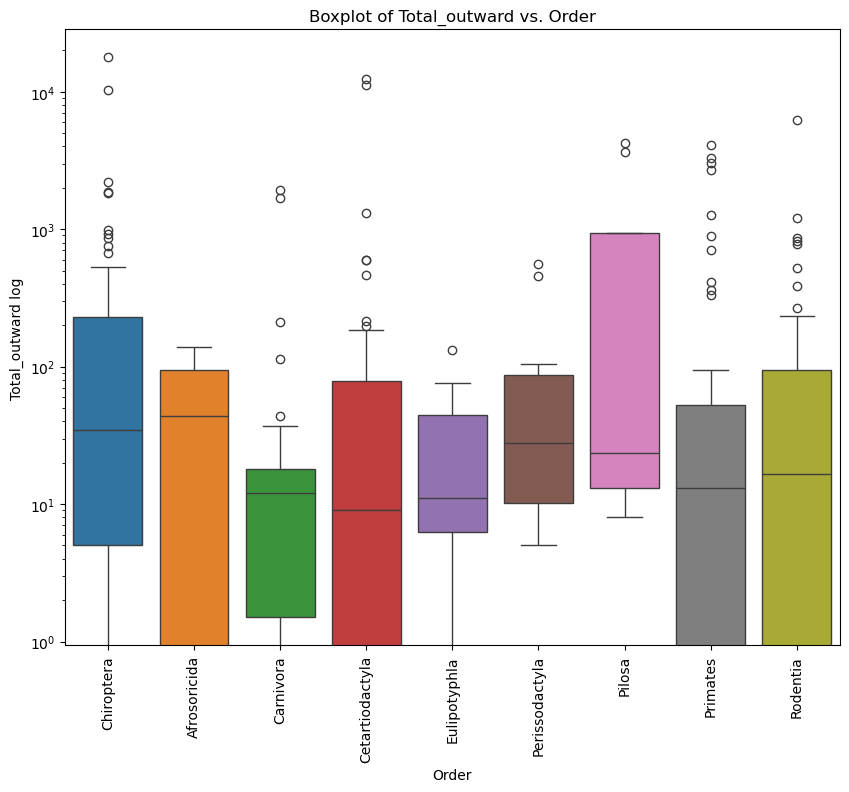

In [22]:

columns = ['Total_fusions_0', 'Total_fusions', 'Inward_distance_0', 'Outward_distance_0', 'Total_inward', 'Total_outward']

for column in columns:
    df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')

    df = df[[column, 'Order']]
    df = df.groupby('Order').filter(lambda x: len(x) >= 5)
    #df[column] = df[column].replace(0, 0.001)
    plt.figure(figsize=(10, 8))

    sns.boxplot(x='Order', y=column, data=df, hue='Order', palette='tab10')

    plt.xlabel('Order')
    plt.xticks(rotation=90)  
    plt.ylabel(column + ' log')
    plt.title(f'Boxplot of {column} vs. Order')

    # To see better the results I controled the df data to cut the noise and see better representation of the data
    plt.yscale('log')

    plt.show()

comparing variability and other variables vs order boxplot

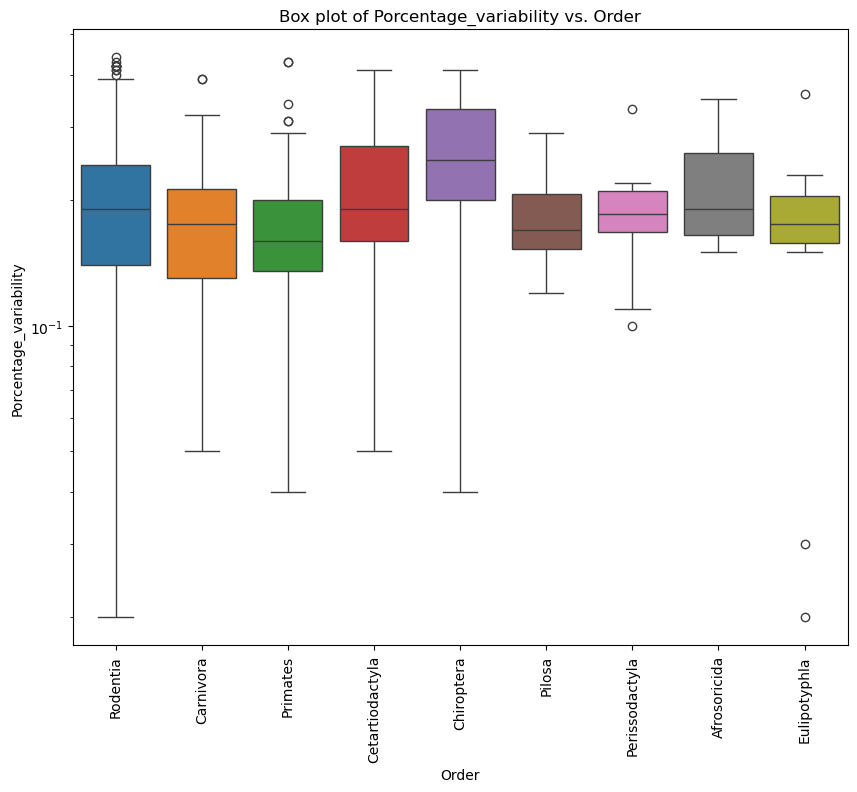

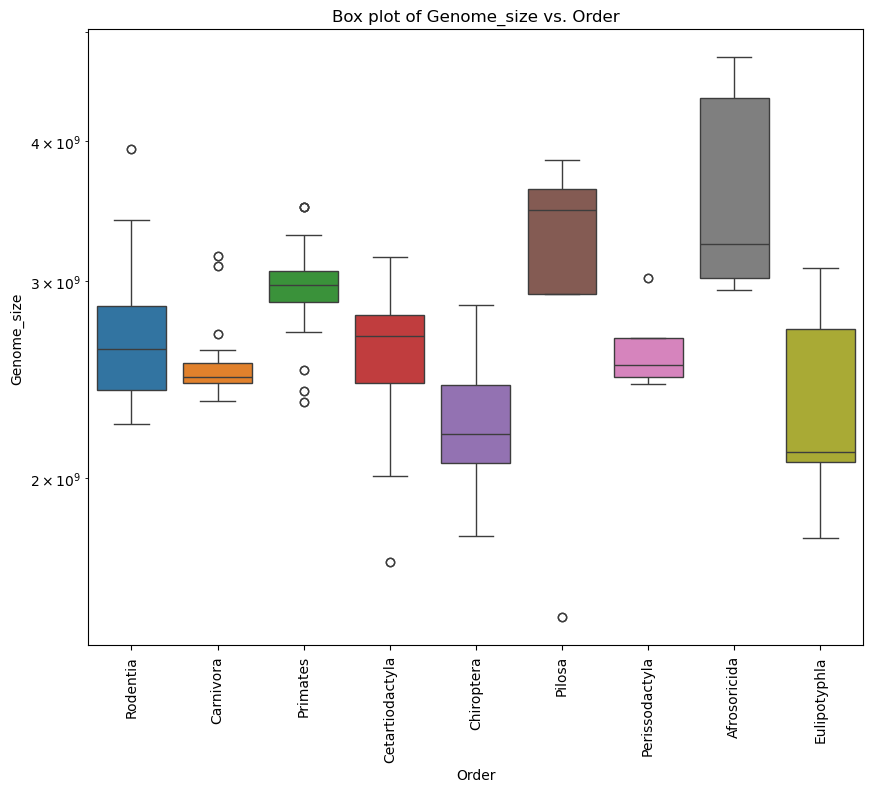

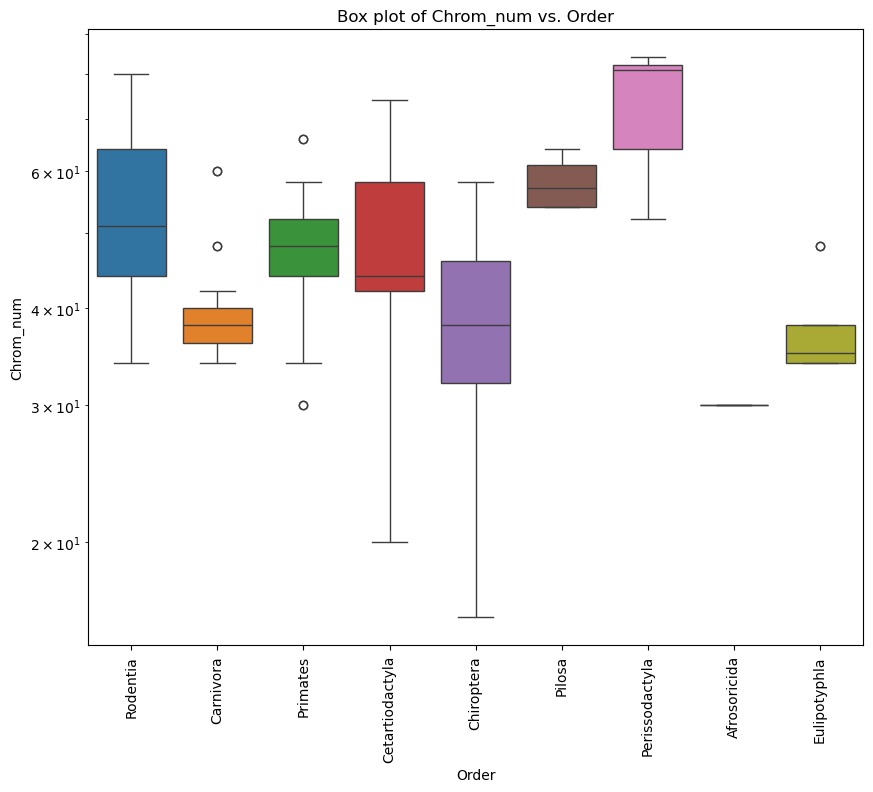

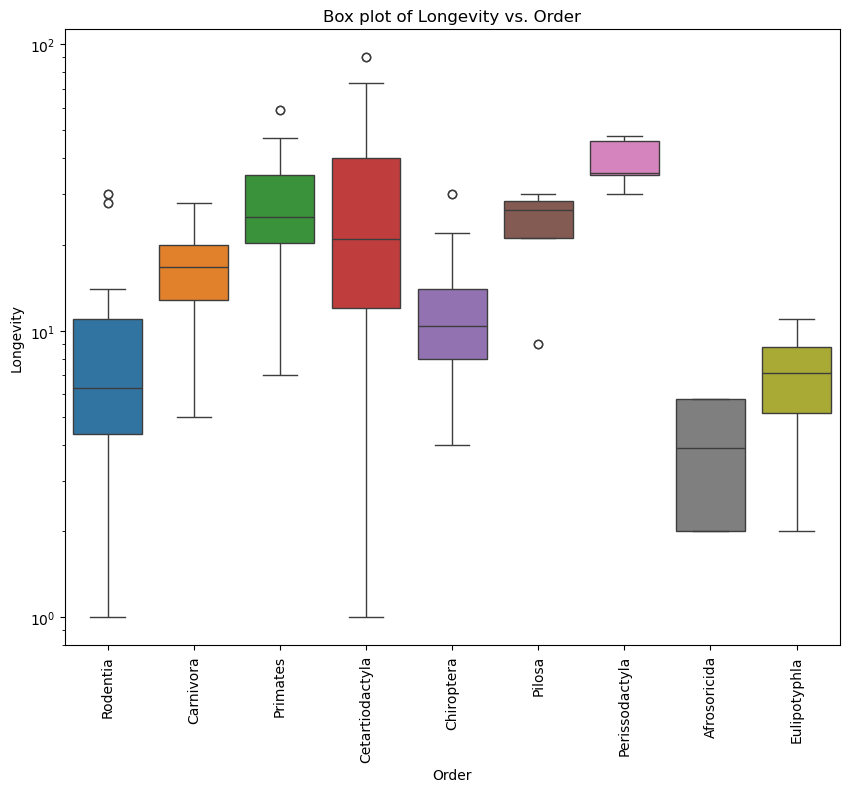

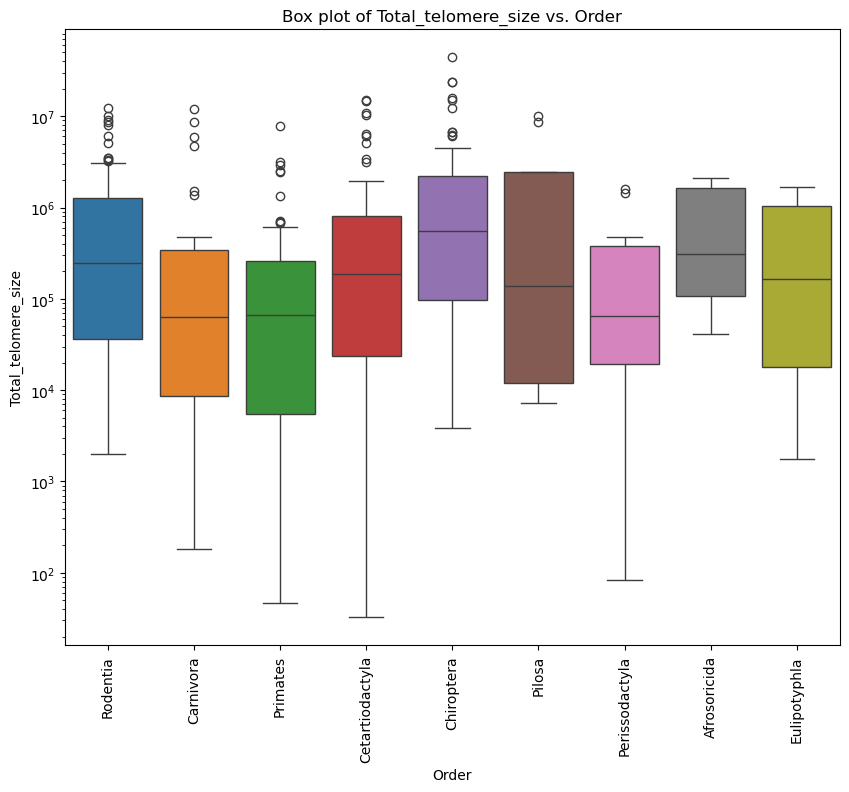

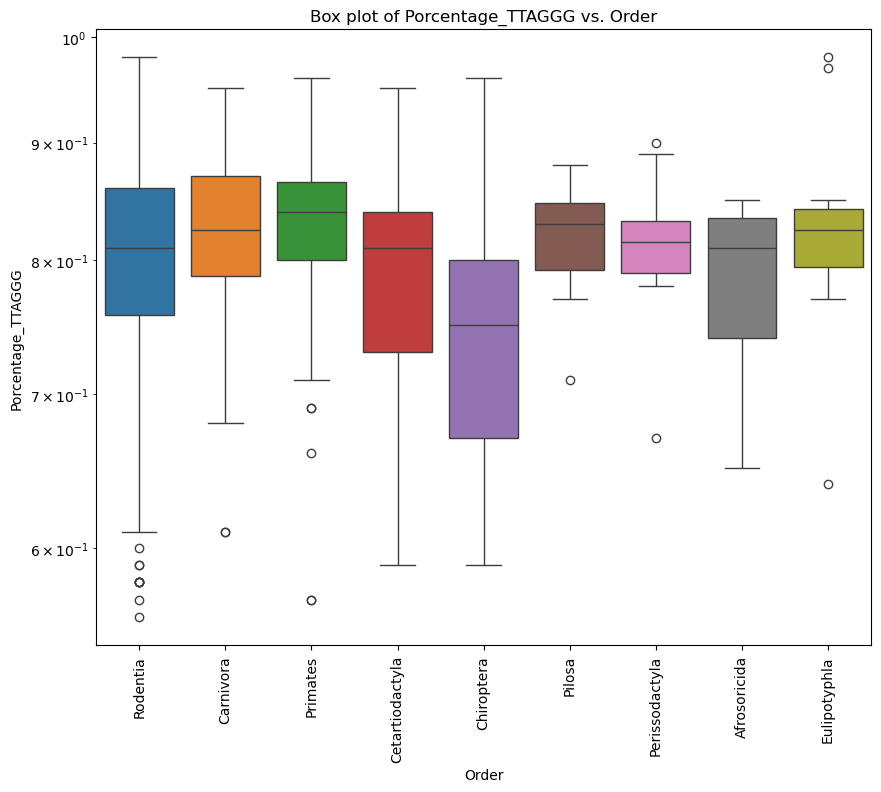

In [43]:
columns = ['Porcentage_variability', 'Genome_size' ,'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']

for column in columns:
    df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')


    df = df[[column, 'Order']]
    df = df.groupby('Order').filter(lambda x: len(x) >= 5)
    
    plt.figure(figsize=(10, 8))

    sns.boxplot(x='Order', y=column, data=df, hue='Order', palette='tab10')

    plt.xlabel('Order')
    plt.xticks(rotation=90)  
    plt.ylabel(column)
    plt.title(f'Box plot of {column} vs. Order')
    plt.yscale('log')
    plt.show()

Calculation of p-value of each column of human and mouse

In [429]:
#df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')

df = df.dropna(thresh=df.shape[1] - 4)
#df = df[df['Instrument_model'] != 'NextSeq 500']
#df = df[~df['Species_name'].str.endswith('_2')]

protein_columns = df.filter(like='_g_').columns
total_fusions_0 = df['Total_fusions_0']
total_fusions = df['Total_fusions']
Inward_0 = df['Inward_distance_0']
Outward_0 = df['Outward_distance_0']
variability = df['Porcentage_variability']
telomere_size = df['Total_telomere_size']

p_values_k_I = {}
p_values_k_F = {}
p_values_k_O = {}
p_values_k_T = {}
p_values_k_V = {}
p_values_k_S = {}

for protein in protein_columns:
    group_T = [total_fusions_0[df[protein] == category] for category in [True, False]]
    group_F = [total_fusions[df[protein] == category] for category in [True, False]]
    group_I = [Inward_0[df[protein] == category] for category in [True, False]]
    group_O = [Outward_0[df[protein] == category] for category in [True, False]]
    group_V = [variability[df[protein] == category] for category in [True, False]]
    group_S = [telomere_size[df[protein] == category] for category in [True, False]]
    
    stat, p_value_t = kruskal(*group_T)
    stat, p_value_f = kruskal(*group_F)
    stat, p_value_i = kruskal(*group_I)
    stat, p_value_o = kruskal(*group_O)
    stat, p_value_v = kruskal(*group_V)
    stat, p_value_s = kruskal(*group_S)

    p_values_k_T[protein] = p_value_t
    p_values_k_F[protein] = p_value_f
    p_values_k_I[protein] = p_value_o
    p_values_k_O[protein] = p_value_i
    p_values_k_V[protein] = p_value_v
    p_values_k_S[protein] = p_value_s



In [430]:
p_values_T_series = pd.Series(p_values_k_T, name='Total_fusions_0')
p_values_F_series = pd.Series(p_values_k_F, name='Total_fusions')
p_values_I_series = pd.Series(p_values_k_I, name='Inward_distance_0')
p_values_O_series = pd.Series(p_values_k_O, name='Outward_distance_0')
p_values_V_series = pd.Series(p_values_k_V, name='Porcentage_variability')
p_values_S_series = pd.Series(p_values_k_S, name='Total_telomere_size')


result_df = pd.concat([p_values_T_series, p_values_F_series, p_values_I_series, p_values_O_series, p_values_V_series, p_values_S_series], axis=1)
result_df.to_excel('kruskal_mouse_p_values.xlsx', index=True)


Showing the P-values of fusion data against proteins

Mouse

Total_fusions_0


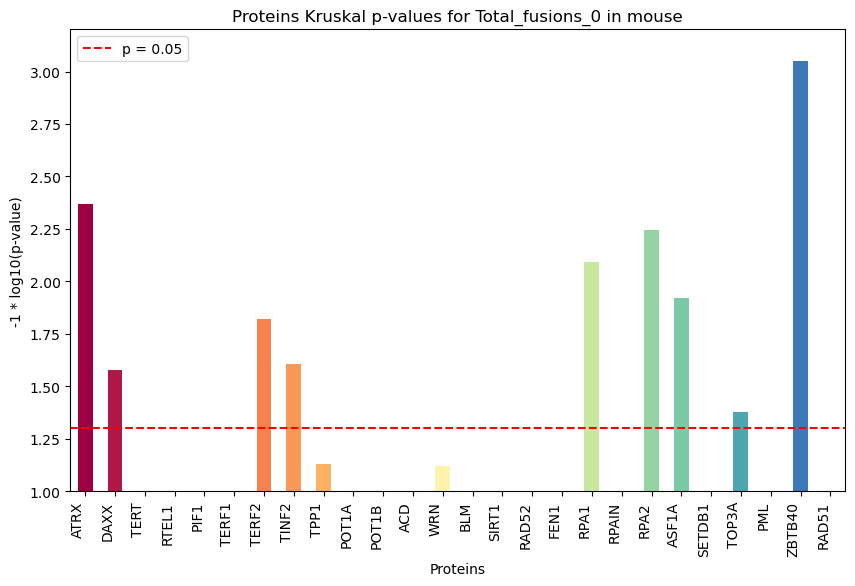

Total_fusions


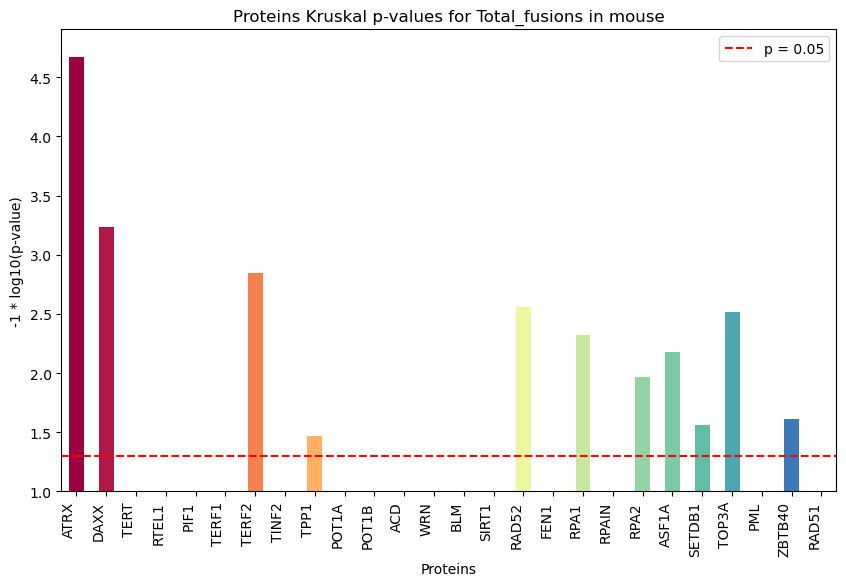

Inward_distance_0


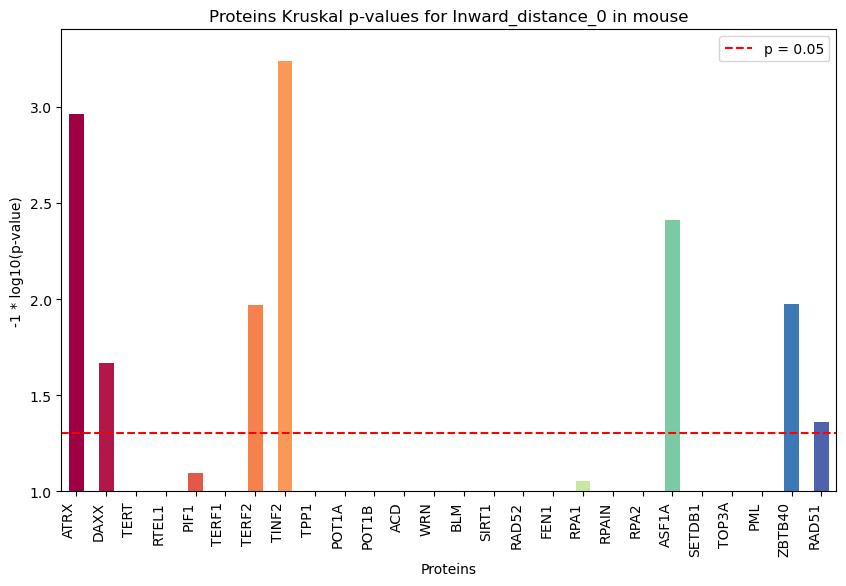

Outward_distance_0


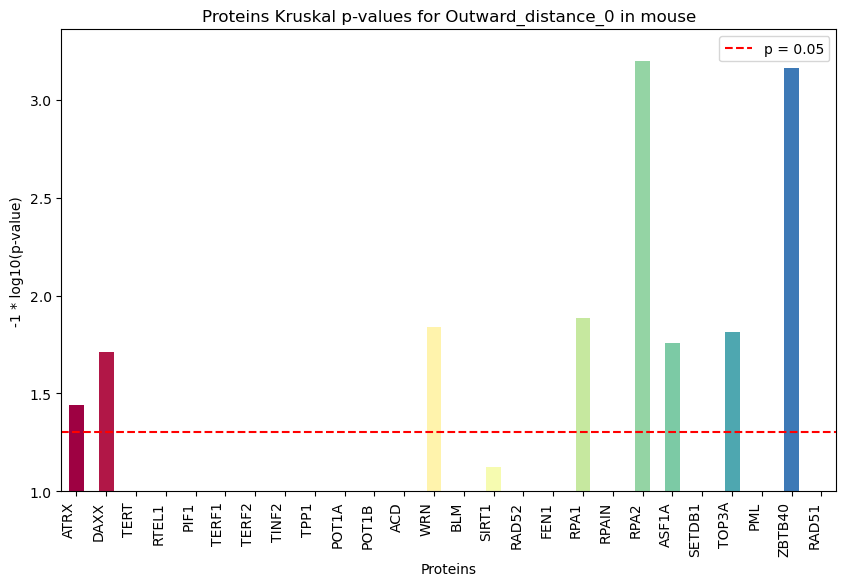

Porcentage_variability


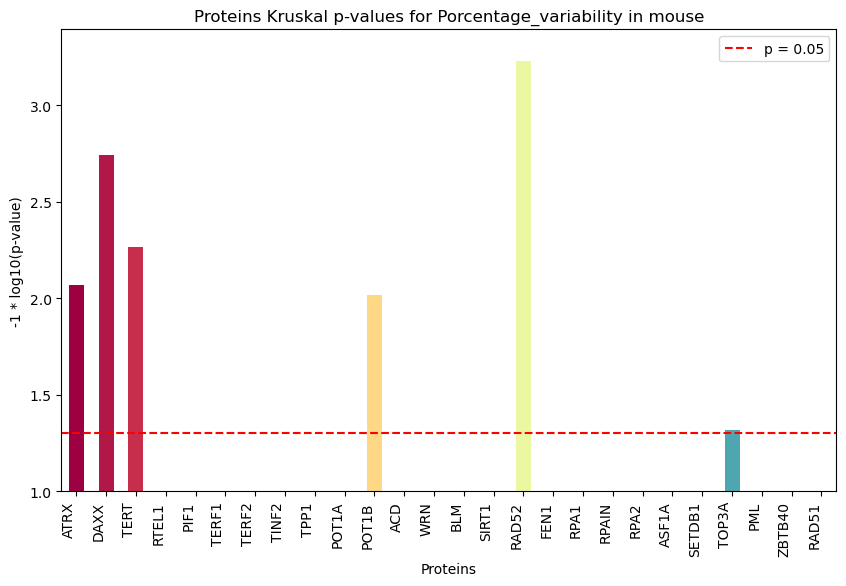

Total_telomere_size


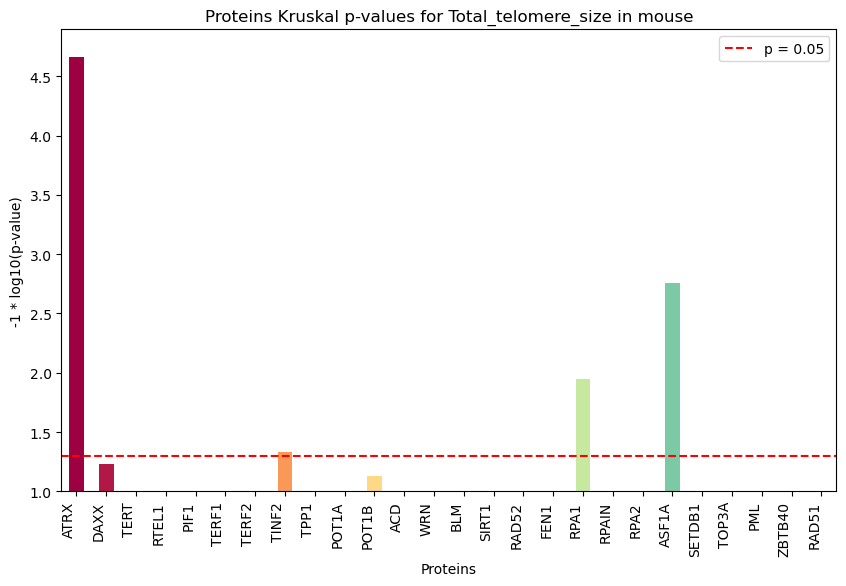

In [37]:
result_df = pd.read_excel('kruskal_mouse_p_values.xlsx', index_col=0)
result_df = result_df.fillna(1)
significance_level = -1 * np.log10(0.05)

cmap = colormaps.get_cmap('Spectral')

def process_protein_name(name):
    return name.split('_')[0]

for column in result_df.columns:
    transformed_values = -1 * np.log10(result_df[column])
    transformed_values.index = transformed_values.index.map(process_protein_name)
    
    plt.figure(figsize=(10, 6))
    print(column)
 
    transformed_values.plot(kind='bar', color=[cmap(i / len(transformed_values.index)) for i in range(len(transformed_values.index))])

    plt.xlabel('Proteins')
    plt.ylabel('-1 * log10(p-value)')
    plt.title(f'Proteins Kruskal p-values for {column} in mouse')
    plt.axhline(y=significance_level, color='red', linestyle='--', label='p = 0.05')  
    plt.xticks(rotation=90, ha='right')
    plt.ylim(1, plt.ylim()[1])
    plt.legend(['p = 0.05'])
    
    # Mostrar el gráfico
    plt.show()




human

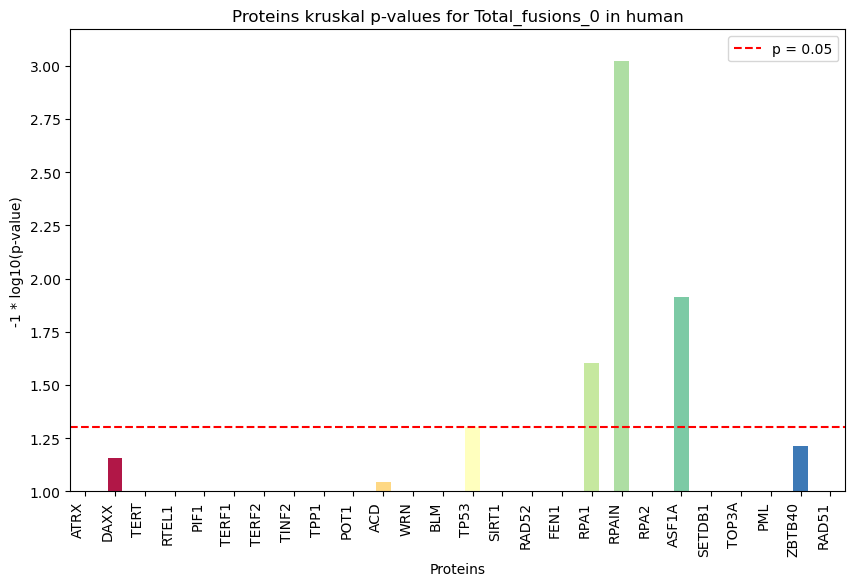

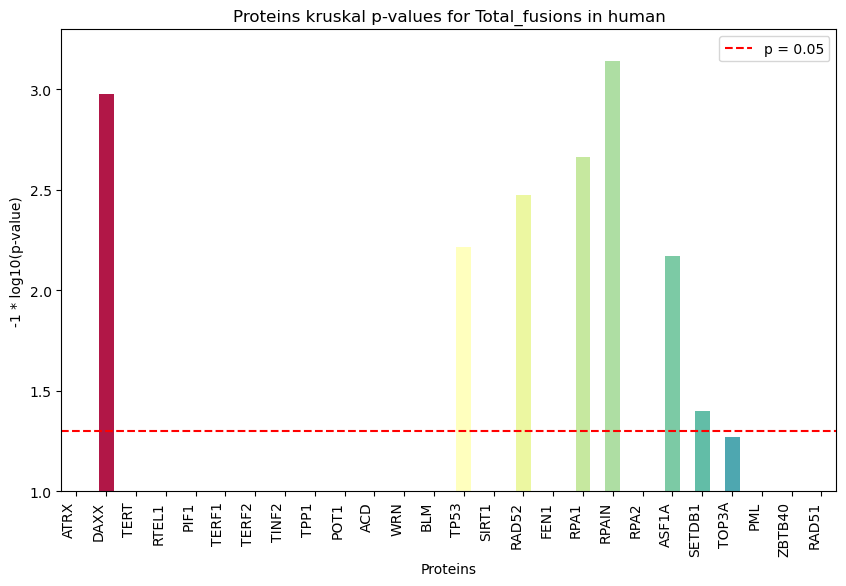

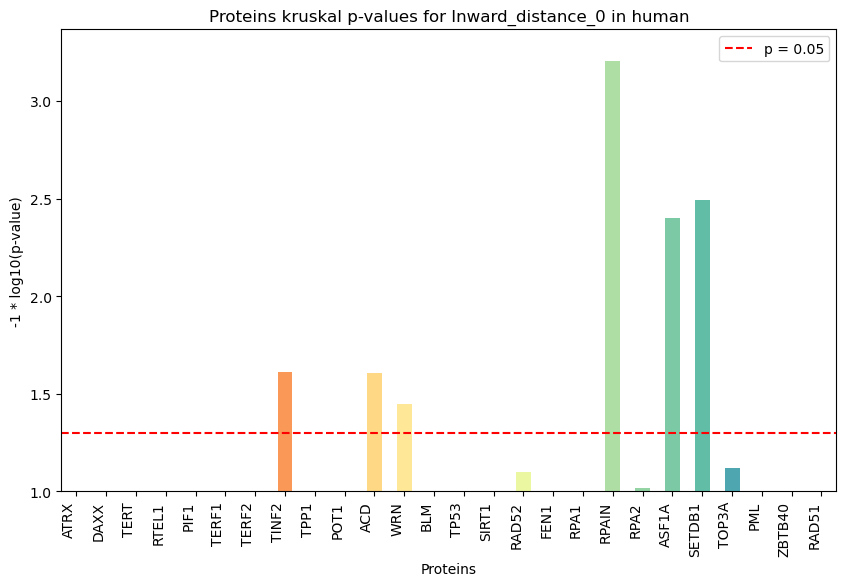

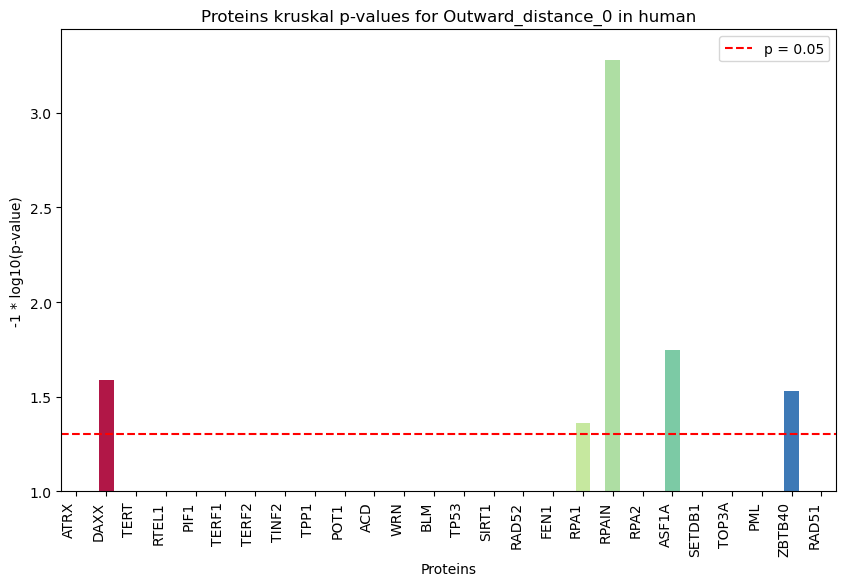

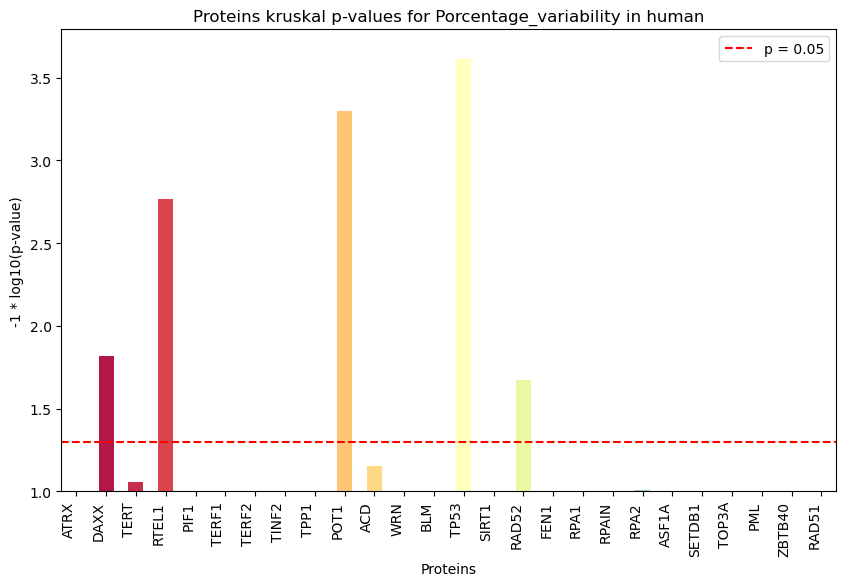

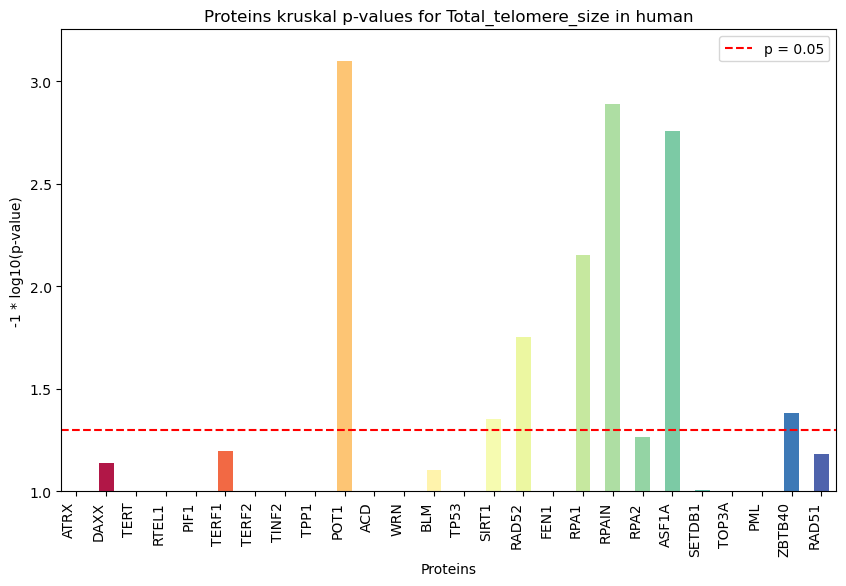

In [38]:
result_df = pd.read_excel('kruskal_human_p_values.xlsx', index_col=0)
result_df = result_df.fillna(1)
significance_level = -1 * np.log10(0.05)

cmap = colormaps.get_cmap('Spectral')

def process_protein_name(name):
    return name.split('_')[0]

for column in result_df.columns:
    transformed_values = -1 * np.log10(result_df[column])
    transformed_values.index = transformed_values.index.map(process_protein_name)
    
    plt.figure(figsize=(10, 6))
    
 
    transformed_values.plot(kind='bar', color=[cmap(i / len(transformed_values.index)) for i in range(len(transformed_values.index))])

    plt.xlabel('Proteins')
    plt.ylabel('-1 * log10(p-value)')
    plt.title(f'Proteins kruskal p-values for {column} in human')
    plt.axhline(y=significance_level, color='red', linestyle='--', label='p = 0.05')  
    plt.xticks(rotation=90, ha='right')
    plt.ylim(1, plt.ylim()[1])
    plt.legend(['p = 0.05'])
    
    plt.show()


Calculating of p-value with diferente categoritation by order

A (absence), U (uncertain) and P (presence)

In [167]:
#df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
df_filtered = df.groupby('Order').filter(lambda x: len(x) >= 5)

protein_columns = df.filter(like='_g_').columns

all_p_values_list = []

grouped_by_order = df_filtered.groupby('Order')

df_t = pd.DataFrame()
df_i = pd.DataFrame()
df_o = pd.DataFrame()
for order, group in grouped_by_order:
    print(f"Analizando Order: {order}")
    
    p_values_t_dict = {}
    p_values_i_dict = {}
    p_values_o_dict = {}
    
    total_fusions_0 = group['Total_fusions_0']
    inward_0 = group['Inward_distance_0']
    outward_0 = group['Outward_distance_0']
    group_t = []
    group_i = []
    group_o = []

    for protein in protein_columns:
        for category in [True, False]:
            data_0 = total_fusions_0[group[protein] == category]
            data_i = inward_0[group[protein] == category]
            data_o = outward_0[group[protein] == category]
            
            if data_0.empty:
                group_t.append([0])
            else:
                group_t.append(data_0)
            if data_i.empty:
                group_i.append([0])
            else:
                group_i.append(data_i)
            if data_o.empty:
                group_o.append([0])
            else:
                group_o.append(data_o)
          
        _, p_value_t = kruskal(*group_t)
        _, p_value_i = kruskal(*group_i)
        _, p_value_o = kruskal(*group_o)
         
        p_values_t_dict[protein] = p_value_t
        p_values_i_dict[protein] = p_value_i
        p_values_o_dict[protein] = p_value_o
    
    order_p_values_df_t = pd.DataFrame.from_dict(p_values_t_dict, orient='index', columns=[f'{order}'])
    order_p_values_df_i = pd.DataFrame.from_dict(p_values_i_dict, orient='index', columns=[f'{order}'])
    order_p_values_df_o = pd.DataFrame.from_dict(p_values_o_dict, orient='index', columns=[f'{order}'])
    df_t = pd.concat([df_t, order_p_values_df_t], axis=1)
    df_i = pd.concat([df_i, order_p_values_df_i], axis=1)
    df_o = pd.concat([df_o, order_p_values_df_o], axis=1)



Analizando Order: Afrosoricida
Analizando Order: Carnivora
Analizando Order: Cetartiodactyla
Analizando Order: Chiroptera
Analizando Order: Eulipotyphla
Analizando Order: Perissodactyla
Analizando Order: Pilosa
Analizando Order: Primates
Analizando Order: Rodentia


In [ ]:
suma_columnas = df_t.sum()
columnas_ordenadas = suma_columnas.sort_values(ascending=True).index
df_t = df_t[columnas_ordenadas]

plt.figure(figsize=(15, 10))
sns.heatmap(df_t, annot=True, cmap='coolwarm', vmin=0, vmax=0.05, fmt=".4g")
plt.title('Heatmap p_value per Order')
plt.xlabel('Order')
plt.ylabel('Proteins')
plt.show()

Using fusion data from fasta file and showing up

Outward fusions

<Figure size 800x2250 with 0 Axes>

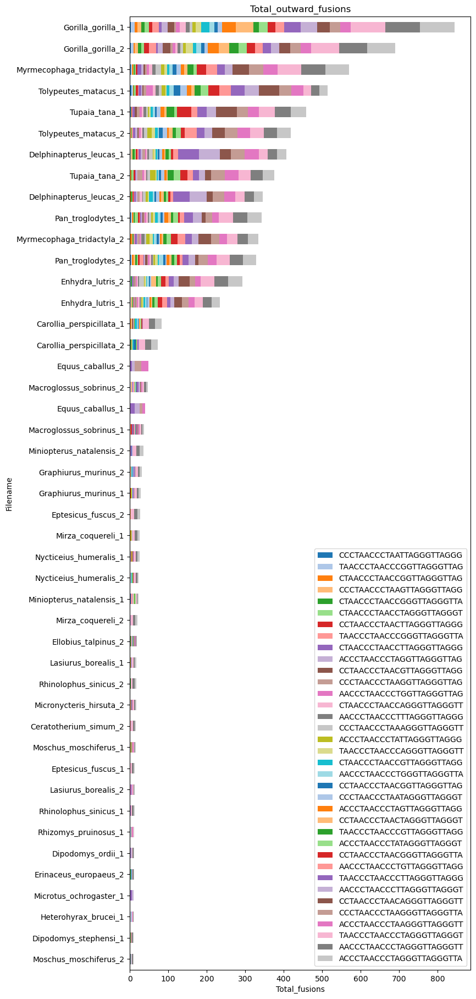

In [20]:


df = pd.read_excel('Final_results_mammals/fusion_frequency_outward.xlsx', index_col=0)
order_column = df['Order']
df = df.drop(columns=['Order'])

sum_fusions = df.sum(axis=1)
df_filtered = df[sum_fusions >= 10]
df_filtered = df_filtered.loc[sum_fusions[sum_fusions >= 10].sort_values(ascending=True).index]
column_sums = df_filtered.sum(axis=0)
df_filtered = df_filtered[column_sums.sort_values(ascending=True).index]

fig_size = (8, len(df_filtered) * 0.5)
plt.figure(figsize=fig_size)

custom_palette = sns.color_palette('tab20', n_colors=40)

df_filtered.plot(kind='barh', stacked=True, figsize=fig_size, color=custom_palette)
plt.ylabel('Filename')
plt.xlabel('Total_fusions')
plt.title('Total_outward_fusions')
plt.legend(loc='lower right')

plt.show()



Pie chart of fusion breakpoints

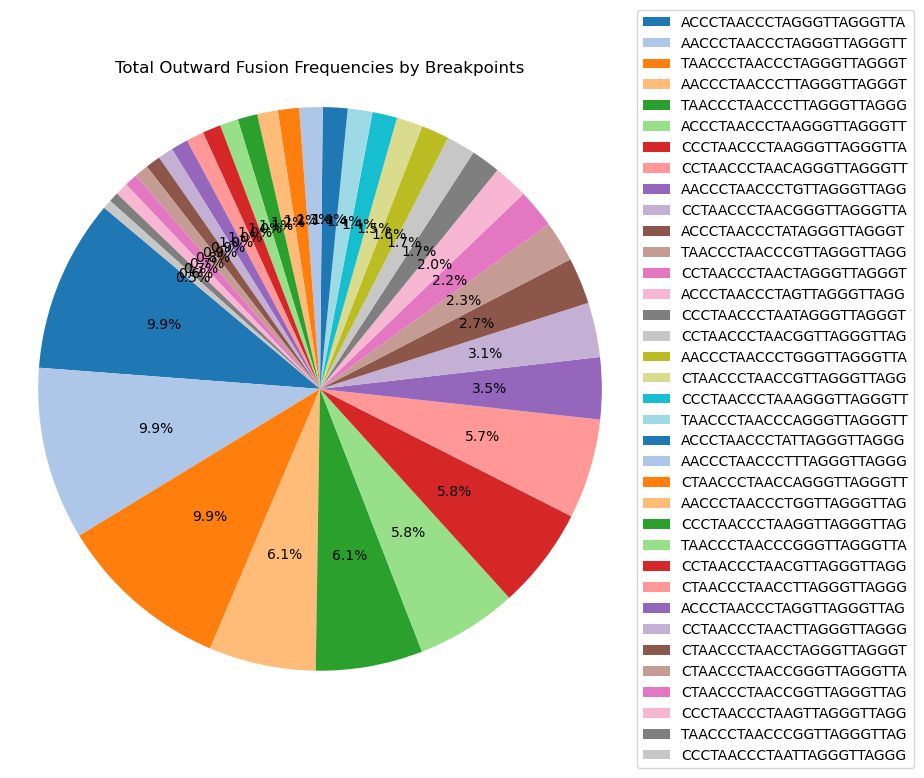

In [24]:
df = pd.read_excel('Final_results_mammals/fusion_frequency_outward.xlsx', index_col=0)
df = df.drop(columns=['Order'])

column_sums = df.sum().sort_values(ascending=False)

plt.figure(figsize=(8, 8))

patches, texts, autotexts = plt.pie(column_sums, autopct='%1.1f%%', startangle=140, colors=plt.cm.tab20.colors)

plt.title('Pie chart total outward fusion frequencies by Breakpoints')

legend_labels = [f'{label}' for label, value in zip(column_sums.index, column_sums.values)]
plt.legend(handles=patches, labels=legend_labels, loc="center left", bbox_to_anchor=(1, 0.5))
plt.axis('equal')
plt.show()

Inward

<Figure size 800x2500 with 0 Axes>

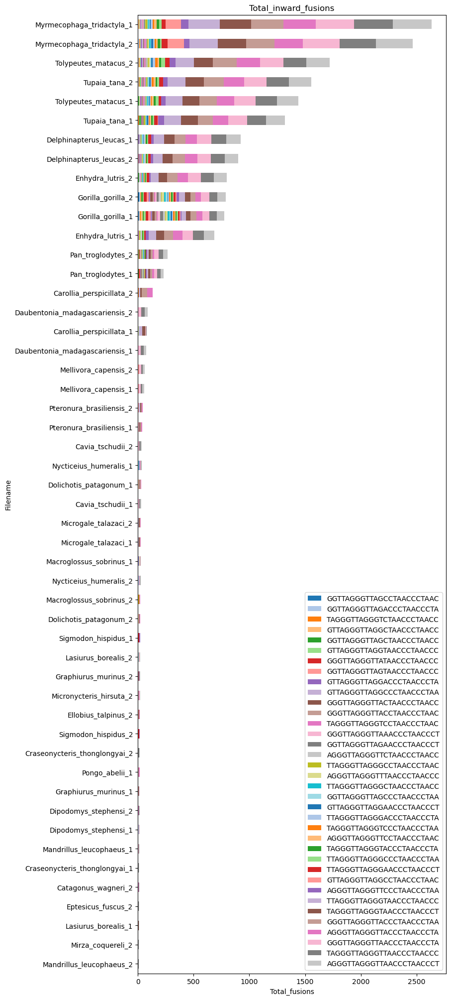

In [21]:

df = pd.read_excel('Final_results_mammals/fusion_frequency_inward.xlsx', index_col=0)
order_column = df['Order']
df = df.drop(columns=['Order'])

sum_fusions = df.sum(axis=1)
df_filtered = df[sum_fusions >= 10]
df_filtered = df_filtered.loc[sum_fusions[sum_fusions >= 10].sort_values(ascending=True).index]
column_sums = df_filtered.sum(axis=0)
df_filtered = df_filtered[column_sums.sort_values(ascending=True).index]

fig_size = (8, len(df_filtered) * 0.5)
plt.figure(figsize=fig_size)

custom_palette = sns.color_palette('tab20', n_colors=40)

df_filtered.plot(kind='barh', stacked=True, figsize=fig_size, color=custom_palette)

plt.ylabel('Filename')
plt.xlabel('Total_fusions')
plt.title('Total_inward_fusions')
plt.legend(loc='lower right')

plt.show()




pie chart 

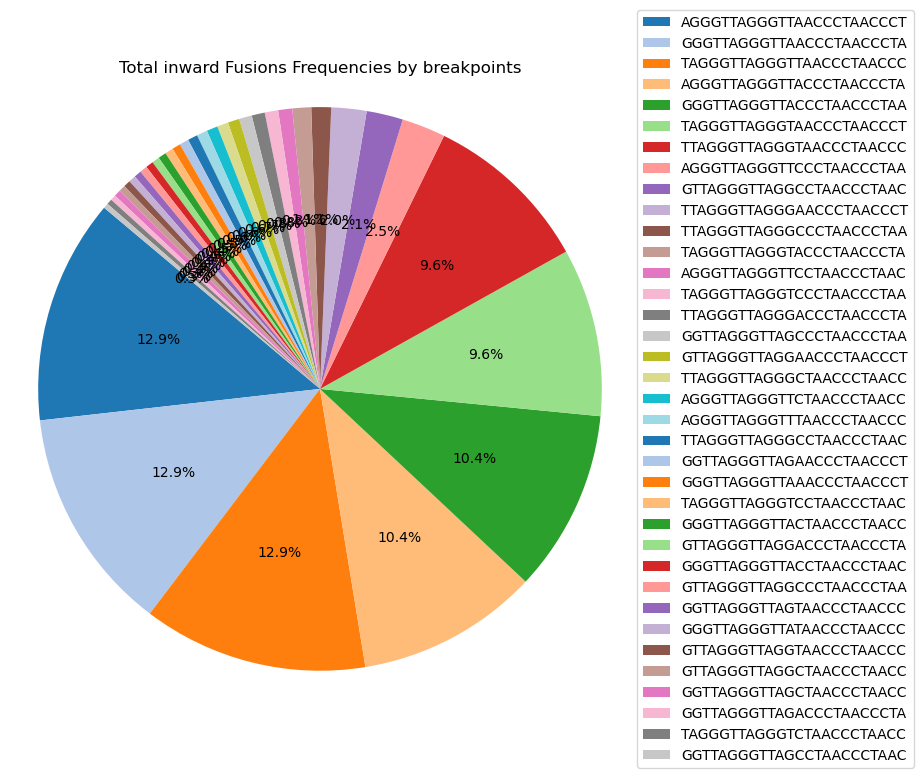

In [23]:

# Leer el DataFrame
df = pd.read_excel('Final_results_mammals/fusion_frequency_inward.xlsx', index_col=0)
df = df.drop(columns=['Order'])

column_sums = df.sum().sort_values(ascending=False)

plt.figure(figsize=(8, 8))

patches, texts, autotexts = plt.pie(column_sums, autopct='%1.1f%%', startangle=140, colors=plt.cm.tab20.colors)

plt.title('Total inward Fusions Frequencies by breakpoints')

legend_labels = [f'{label}' for label, value in zip(column_sums.index, column_sums.values)]
plt.legend(handles=patches, labels=legend_labels, loc="center left", bbox_to_anchor=(1, 0.5))
plt.axis('equal')
plt.show()

PCA of fusion breakpoints

In [ ]:

df_fusions = pd.read_excel('Final_results_mammals/fusion_frequency_inward.xlsx')

df_fusions.reset_index(drop=True)
order_column = df_fusions['Order']
df_fusions = df_fusions.drop(columns=['Order'])

species_columns = df_fusions['Column1']
df_fusions = df_fusions.drop('Column1', axis = 1)

scaler = StandardScaler()
df_fusions_scaled = scaler.fit_transform(df_fusions)

imputer = SimpleImputer(strategy='mean')
df_fusions_imputed = imputer.fit_transform(df_fusions_scaled)

df_fusions_transformed = pd.DataFrame(df_fusions_imputed, columns=df_fusions.columns)

pca = PCA()
principal_components = pca.fit_transform(df_fusions_imputed)

explained_variance_ratio_cumulative = np.cumsum(pca.explained_variance_ratio_)
components = pca.components_
explained_variance = pca.explained_variance_
components_df = pd.DataFrame(components, columns=df_fusions.columns)

for i, component in enumerate(components_df.iterrows(), start=1):

    print(f"Component {component[0]}:")
    print(component[1].sort_values(ascending=False))
    print(f"Explained Variance: {explained_variance[i - 1]}")
    print()

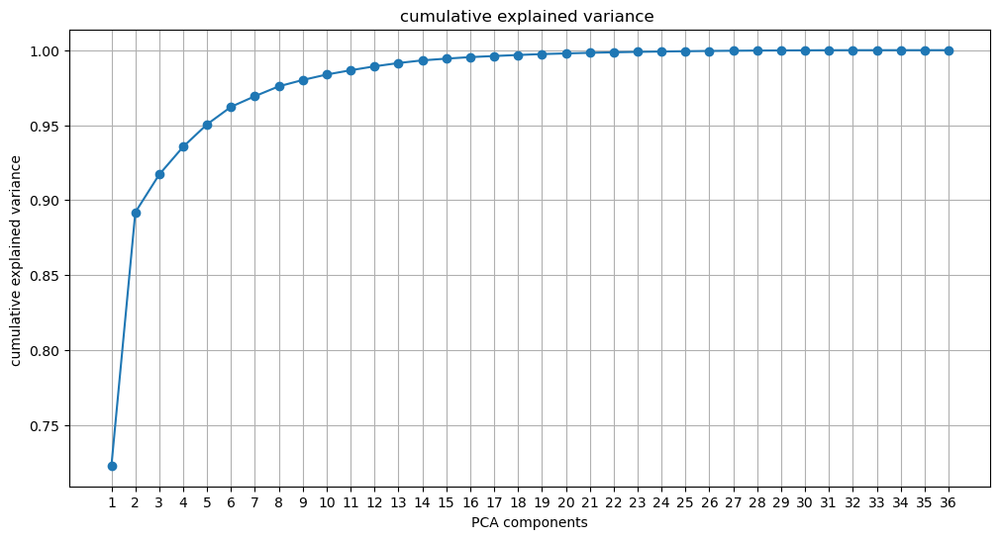

In [53]:
plt.figure(figsize=(12, 6))
plt.plot(np.arange(1, len(explained_variance_ratio_cumulative) + 1), explained_variance_ratio_cumulative, marker='o', linestyle='-')
plt.title('cumulative explained variance ')
plt.xlabel('PCA components')
plt.ylabel('cumulative explained variance ')
plt.xticks(np.arange(1, len(explained_variance_ratio_cumulative) + 1))
plt.grid(True)
plt.show()

In [6]:
df_pca = pd.DataFrame(principal_components[:, :3], columns=['PC1', 'PC2', 'PC3'])
df_pca['Order'] = order_column

fig = px.scatter_3d(df_pca, x='PC1', y='PC2', z='PC3', color='Order', title='PCA 3D Scatter Plot with Clusters by Order')
fig.show()

In [8]:
df_pca_2d = pd.DataFrame(principal_components[:, :2], columns=['PC1', 'PC2'])
df_pca_2d['Order'] = order_column

fig = px.scatter(df_pca_2d, x='PC1', y='PC2', color='Order', title='PCA 2D Scatter Plot with Clusters by Order')
fig.show()

Random forest proteins vs columns of interest

Mouse

In [444]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
#df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
df.drop(['Species_name', 'Species', 'Order', 'Genome_coverage', 'Inward_other', 'Outward_other', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)
df = df.dropna(thresh=df.shape[1] - 4)

columns = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']


feature_importance_dfs_mouse = []
for column in columns:
    column_mean = df[column].mean()
    df[column] = df[column].fillna(column_mean)
    
    y = df[column]
    X = df.filter(like='_g_')
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=80)
    
    rf = RandomForestRegressor(random_state=80)
    rf.fit(X_train, y_train)
    
    y_pred = rf.predict(X_test)
    
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    print(f'Mean Squared Error for {column}: {mse}')
    print(f'R^2 Score for {column}: {r2}')
    
    feature_importances = rf.feature_importances_
    
    feature_importance_df = pd.DataFrame({
        'feature': X.columns,
        'importance': feature_importances
    })
    
    feature_importance_df.sort_values(by='importance', ascending=False, inplace=True)
    feature_importance_df = feature_importance_df.head(100)
    
    info_df = pd.DataFrame({
        'feature': [column, 'Mean Squared Error', 'R^2 Score'],
        'importance': [np.nan, mse, r2]
    })
    
    feature_importance_df = pd.concat([info_df, feature_importance_df]).reset_index(drop=True)
    
    feature_importance_dfs_mouse.append(feature_importance_df)


Mean Squared Error for Total_fusions_0: 1990976.4949504524
R^2 Score for Total_fusions_0: -0.19163789198014847
Mean Squared Error for Total_fusions: 13946002.135543972
R^2 Score for Total_fusions: -1.4771155153916107
Mean Squared Error for Inward_distance_0: 909314.0424011588
R^2 Score for Inward_distance_0: -0.11412602507418379
Mean Squared Error for Outward_distance_0: 274035.49672826286
R^2 Score for Outward_distance_0: -0.26263806071318974
Mean Squared Error for Porcentage_variability: 0.007779711536777791
R^2 Score for Porcentage_variability: 0.07780174613965463
Mean Squared Error for Chrom_num: 193.1326476423875
R^2 Score for Chrom_num: 0.25526241169296005
Mean Squared Error for Longevity: 208.46524493459546
R^2 Score for Longevity: 0.28579416760074283
Mean Squared Error for Total_telomere_size: 15069920936818.133
R^2 Score for Total_telomere_size: -0.17267834309164365
Mean Squared Error for Porcentage_TTAGGG: 0.007779987594357305
R^2 Score for Porcentage_TTAGGG: 0.07776902258472

Total_fusions_0


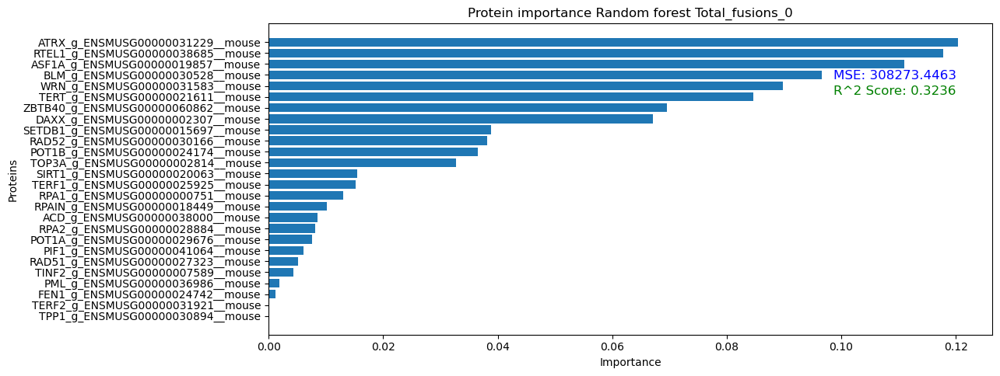

Total_fusions


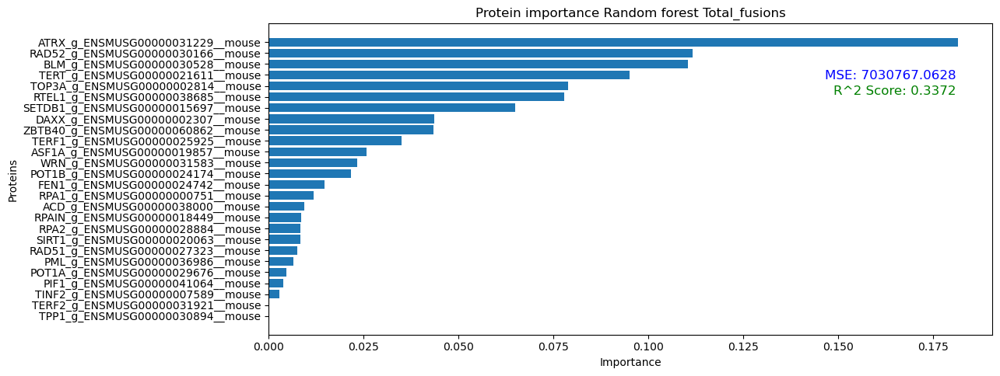

Inward_distance_0


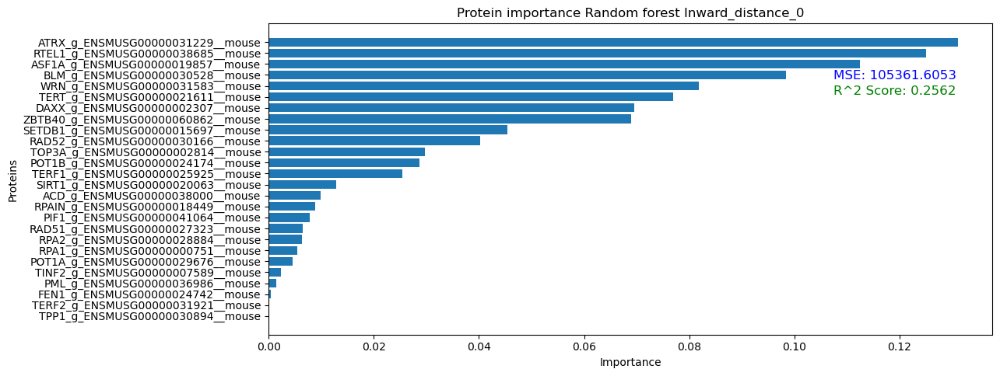

Outward_distance_0


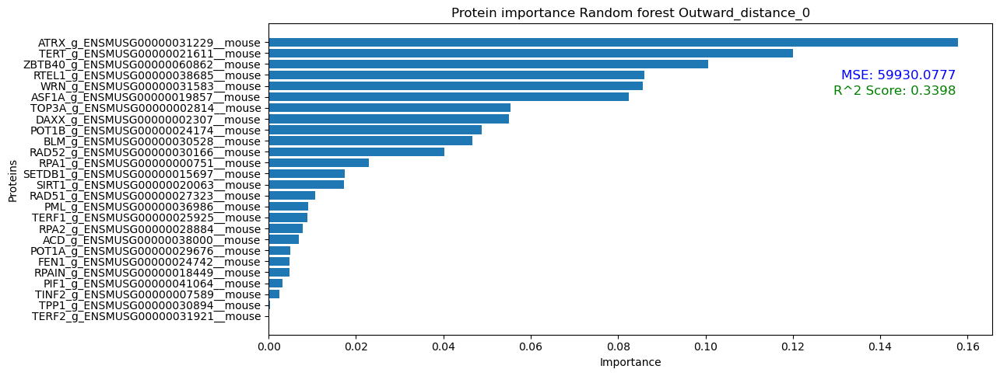

Porcentage_variability


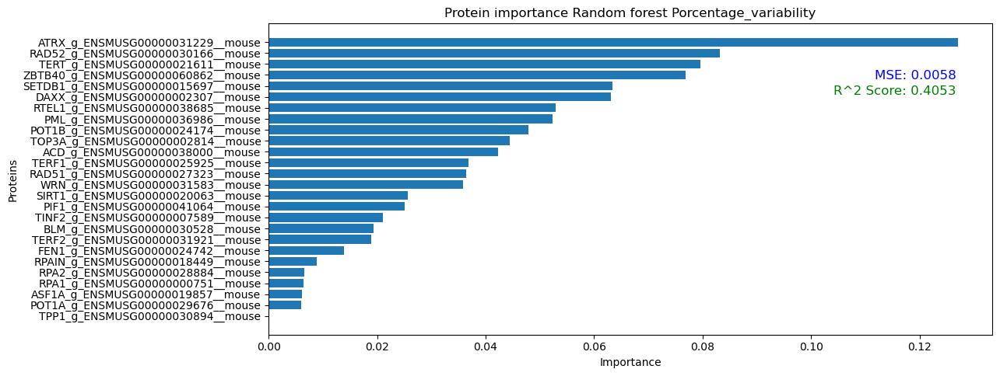

Chrom_num


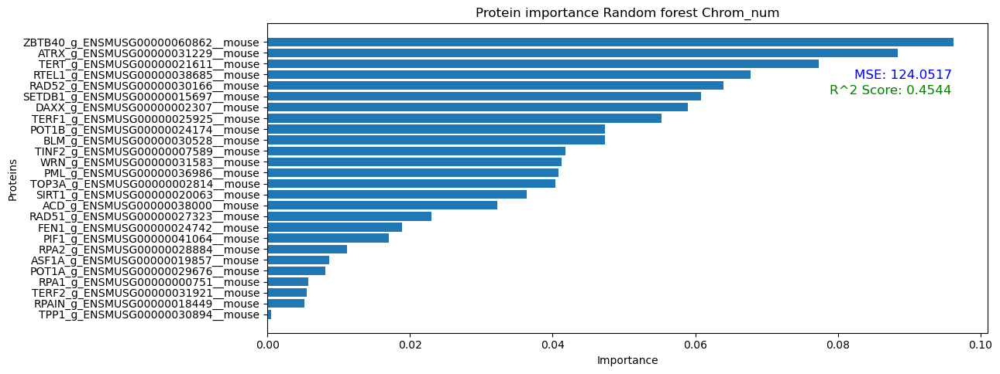

Longevity


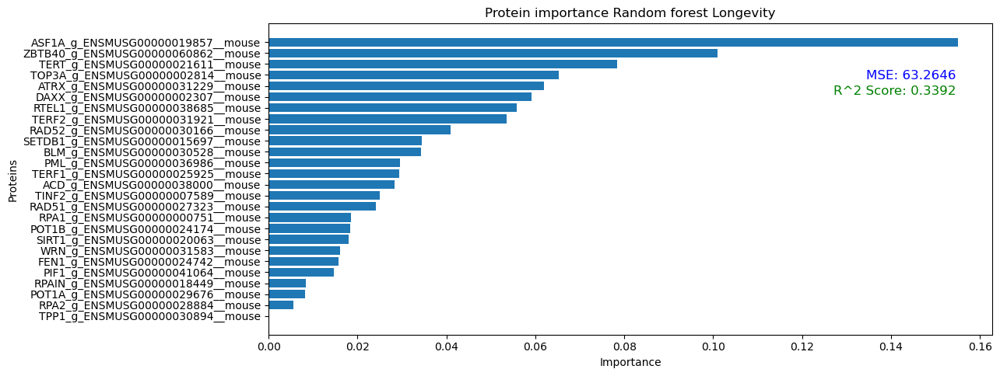

Total_telomere_size


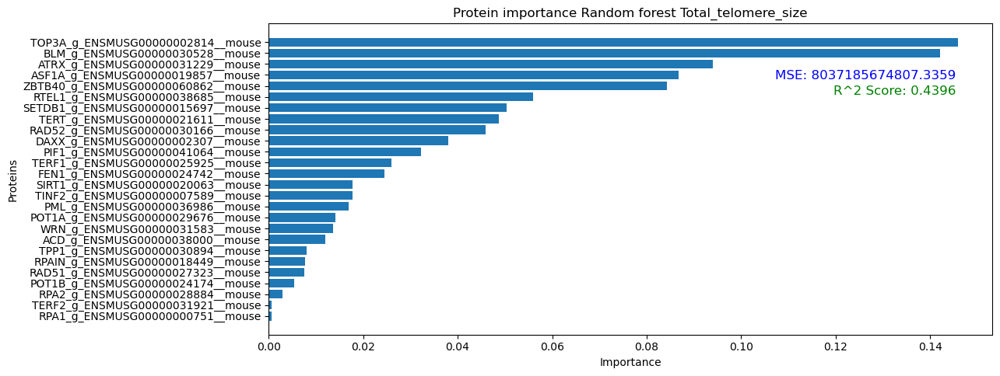

Porcentage_TTAGGG


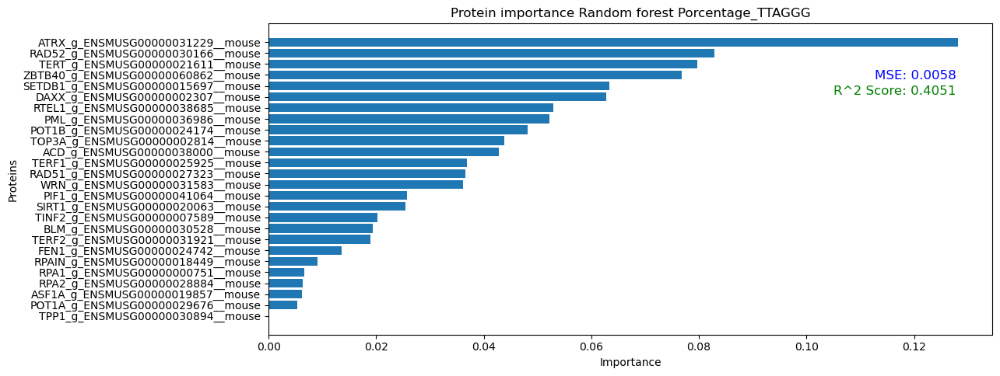

In [443]:
for feature_importance_df in feature_importance_dfs_mouse:
    column_name = feature_importance_df.iloc[0, 0]
    mean_squared_error = feature_importance_df.iloc[1, 1]
    R_Score = feature_importance_df.iloc[2, 1]

    feature_importance_df = feature_importance_df.iloc[3:]
    
    
    feature_importance_df_sorted = feature_importance_df.sort_values(by='importance', ascending=False)
    
    print(column_name)
     
    num_features = len(feature_importance_df_sorted)
    figsize = (12, max(5, num_features / 5))
    plt.figure(figsize=figsize)
    plt.barh(feature_importance_df_sorted['feature'], feature_importance_df_sorted['importance'])
    plt.xlabel('Importance')
    plt.ylabel('Proteins')
    plt.text(0.95, 0.85, f'MSE: {mean_squared_error:.4f}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12, color='blue')
    plt.text(0.95, 0.80, f'R^2 Score: {R_Score:.4f}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12, color='green')

    plt.title(f'Protein importance Random forest {column_name}')
    plt.gca().invert_yaxis() 
    plt.show()

Rando forest proteins vs fusions

Human

In [445]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
#df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_mouse.xlsx')
df = pd.read_excel('zoonomia_analysis_data_boolean_coverage_human.xlsx')
df.drop(['Species_name', 'Species', 'Order', 'Genome_coverage', 'Inward_other', 'Outward_other', 'Instrument_model', 'Average_bp_read'], axis=1, inplace=True)
df = df.dropna(thresh=df.shape[1] - 4)

columns = ['Total_fusions_0', 'Total_fusions', 
           'Inward_distance_0', 'Outward_distance_0', 
           'Porcentage_variability', 'Chrom_num', 'Longevity', 'Total_telomere_size', 'Porcentage_TTAGGG']


feature_importance_dfs_human = []
for column in columns:
    column_mean = df[column].mean()
    df[column] = df[column].fillna(column_mean)
    
    y = df[column]
    X = df.filter(like='_g_')
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=80)
    
    rf = RandomForestRegressor(random_state=80)
    rf.fit(X_train, y_train)
    
    y_pred = rf.predict(X_test)
    
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    print(f'Mean Squared Error for {column}: {mse}')
    print(f'R^2 Score for {column}: {r2}')
    
    feature_importances = rf.feature_importances_
    
    feature_importance_df = pd.DataFrame({
        'feature': X.columns,
        'importance': feature_importances
    })
    
    feature_importance_df.sort_values(by='importance', ascending=False, inplace=True)
    feature_importance_df = feature_importance_df.head(100)
    
    info_df = pd.DataFrame({
        'feature': [column, 'Mean Squared Error', 'R^2 Score'],
        'importance': [np.nan, mse, r2]
    })
    
    feature_importance_df = pd.concat([info_df, feature_importance_df]).reset_index(drop=True)
    feature_importance_dfs_human.append(feature_importance_df)


Mean Squared Error for Total_fusions_0: 584614.9745405704
R^2 Score for Total_fusions_0: 0.34167128929100166
Mean Squared Error for Total_fusions: 12549577.459137075
R^2 Score for Total_fusions: -0.024808586333034288
Mean Squared Error for Inward_distance_0: 216079.15989164985
R^2 Score for Inward_distance_0: 0.48572756574690945
Mean Squared Error for Outward_distance_0: 95929.22233260673
R^2 Score for Outward_distance_0: 0.10378487593790464
Mean Squared Error for Porcentage_variability: 0.006251978396526007
R^2 Score for Porcentage_variability: 0.06966463477271079
Mean Squared Error for Chrom_num: 197.91731838066548
R^2 Score for Chrom_num: -0.6541659684686587
Mean Squared Error for Longevity: 97.67732407432757
R^2 Score for Longevity: 0.24712807446727447
Mean Squared Error for Total_telomere_size: 8906438747271.018
R^2 Score for Total_telomere_size: 0.3092569637994218
Mean Squared Error for Porcentage_TTAGGG: 0.006253936852270666
R^2 Score for Porcentage_TTAGGG: 0.06937320372082134


584614.9745405704
Total_fusions_0


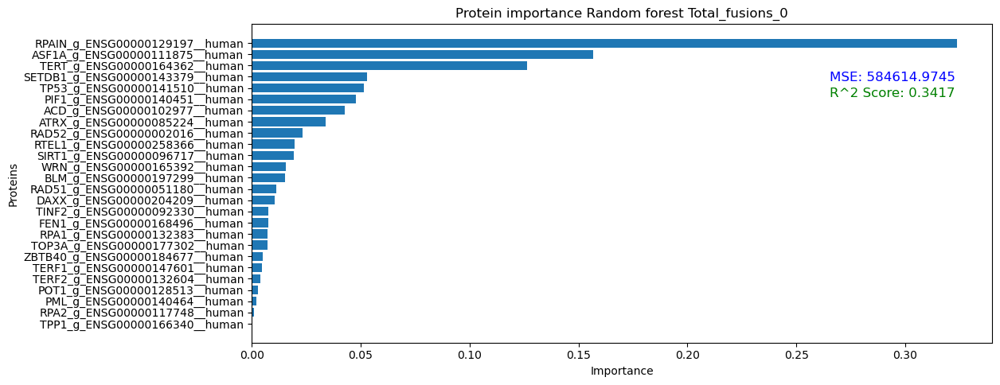

12549577.459137075
Total_fusions


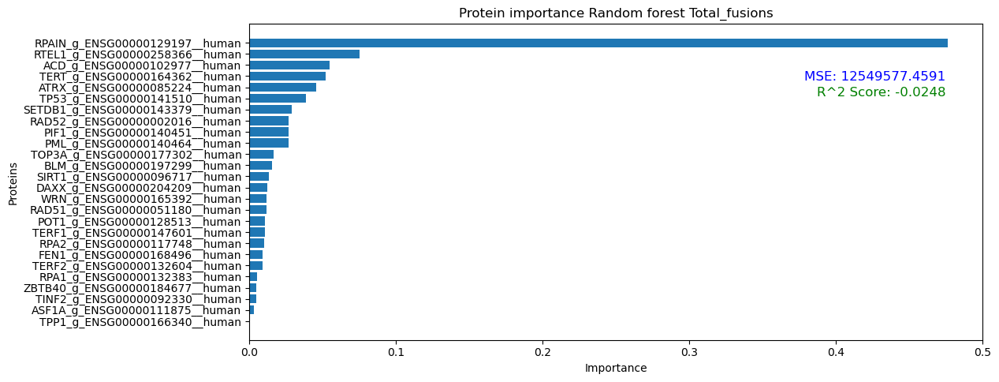

216079.15989164985
Inward_distance_0


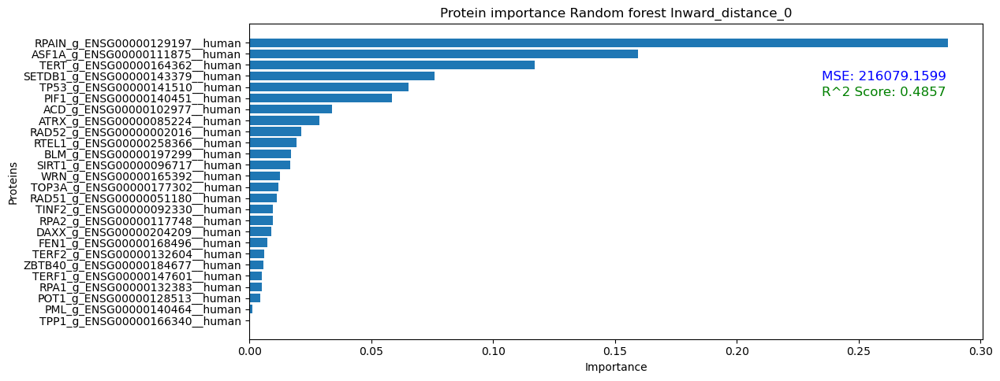

95929.22233260673
Outward_distance_0


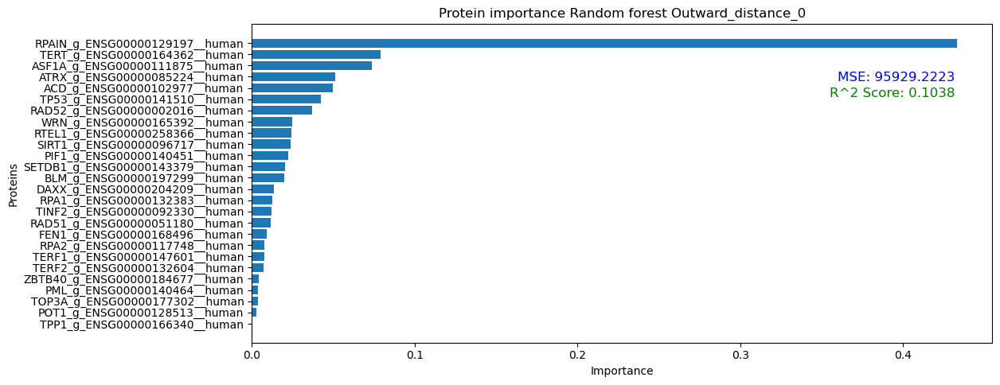

0.006251978396526007
Porcentage_variability


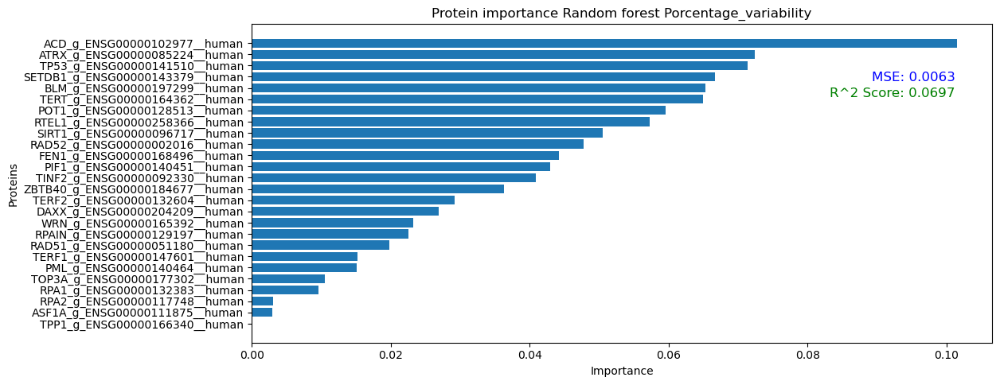

197.91731838066548
Chrom_num


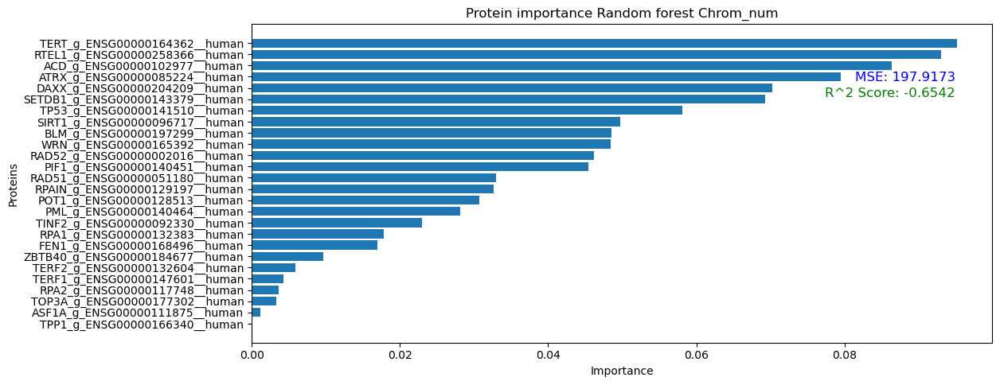

97.67732407432757
Longevity


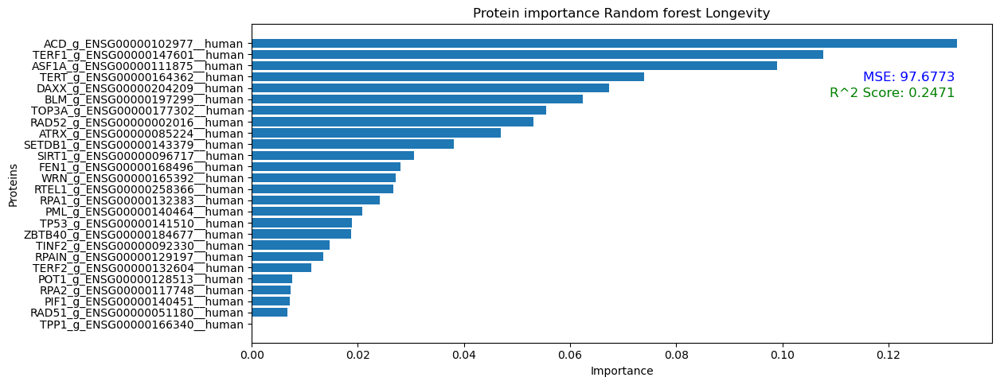

8906438747271.018
Total_telomere_size


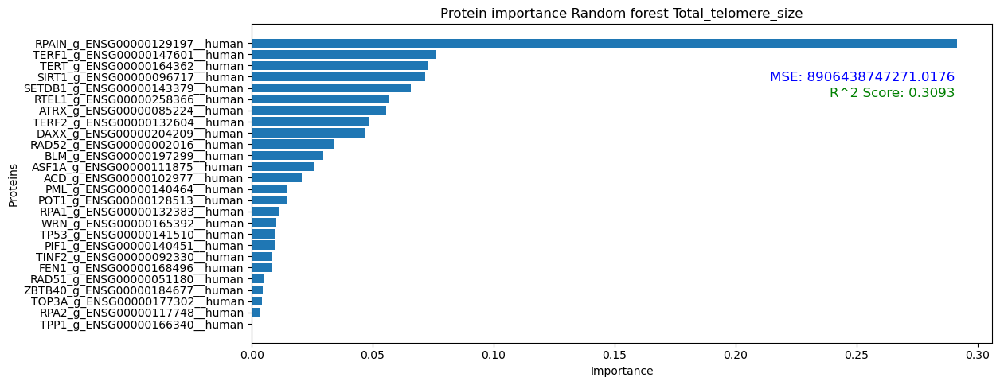

0.006253936852270666
Porcentage_TTAGGG


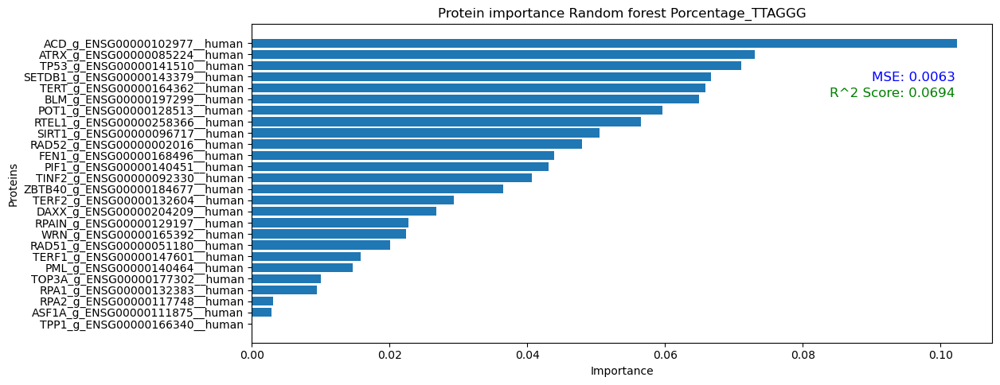

In [446]:
for feature_importance_df in feature_importance_dfs_human:
    column_name = feature_importance_df.iloc[0, 0]
    mean_squared_error = feature_importance_df.iloc[1, 1]
    R_Score = feature_importance_df.iloc[2, 1]
    print(mean_squared_error)
    feature_importance_df = feature_importance_df.iloc[3:]
    
    
    feature_importance_df_sorted = feature_importance_df.sort_values(by='importance', ascending=False)
    
    print(column_name)
     
    num_features = len(feature_importance_df_sorted)
    figsize = (12, max(5, num_features / 5))
    plt.figure(figsize=figsize)
    plt.barh(feature_importance_df_sorted['feature'], feature_importance_df_sorted['importance'])
    plt.xlabel('Importance')
    plt.ylabel('Proteins')
    plt.text(0.95, 0.85, f'MSE: {mean_squared_error:.4f}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12, color='blue')
    plt.text(0.95, 0.80, f'R^2 Score: {R_Score:.4f}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=12, color='green')

    plt.title(f'Protein importance Random forest {column_name}')
    plt.gca().invert_yaxis() 
    plt.show()